In [76]:
import warnings
warnings.simplefilter("ignore", UserWarning)
warnings.simplefilter("ignore", FutureWarning)
warnings.simplefilter("ignore", RuntimeWarning)

import sys
sys.path.append('../../dstorch/')

import pandas as pd
import seaborn
import matplotlib.pyplot as plt
%matplotlib inline
%reload_ext autoreload
%autoreload 2

In [77]:
from dstorch import io, dataset, transforms, losses, models, predict, draw, utils
from dstorch.train import train
from dstorch.utils import variable
import torch.backends.cudnn as cudnn
import torch
import torch.nn as nn
from torch.optim import Adam
from tqdm import tqdm_notebook, tqdm
import numpy as np
import cv2
import skimage
import os

In [3]:
classes = pd.read_csv("../../classes.csv")

TRAIN_PATH = '../../kaggle-dsbowl-2018-dataset-fixes/stage1_train/'
TEST_PATH = '../../stage1_test/'

ids = next(os.walk(TRAIN_PATH))[1]
[train_ids], [val_ids] = utils.train_val_split(classes, ids, ids)

In [348]:
train_transform = transforms.DualCompose(
    [
        transforms.RandomCrop((256, 256)),
        transforms.VerticalFlip(),
        transforms.HorizontalFlip(),
        transforms.Transpose(),
        transforms.ShiftScaleRotate(scale_limit=0.75, prob=1),
        transforms.Distort1(0.5, 0.5),
        transforms.ImageOnly(transforms.RandomBrightness(0.5)),
        transforms.ImageOnly(transforms.RandomContrast(0.5)),
        transforms.ImageOnly(transforms.Normalize(
            mean=[0.485, 0.456, 0.406],
            std=[0.229, 0.224, 0.225]
        ))
    ]
)

val_transform = transforms.DualCompose(
    [
        transforms.ImageOnly(transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                 std=[0.229, 0.224, 0.225]))
    ]
)

train_loader = dataset.make_loader(
    train_ids + val_ids, "../../data/images/{}.png", "../../data/masks/{}.png", 16, 
    transform=train_transform, period=64
)

val_loader = dataset.make_loader(
    val_ids, "../../data/images/{}.png", "../../data/masks/{}.png", 1, 
    transform=val_transform, shuffle=False, mode='validation', period=64
)

In [349]:
model = models.TernausNet34(num_classes=3, num_filters=16, pretrained=True)
loss = losses.BCEDiceLossMCC()

if torch.cuda.is_available():
    model = nn.DataParallel(model).cuda()
    cudnn.benchmark = True

In [361]:
train(
    init_optimizer=lambda lr: Adam(model.parameters(), lr=lr),
    model=model,
    criterion=loss,
    train_loader=train_loader,
    val_loader=val_loader,
    n_epochs=50, 
    batch_size=16,
    lr=0.0001
)

Epoch 2, lr 0.0001:   0%|          | 0/336 [00:00<?, ?it/s]

Valid loss: 0.23515


Epoch 2, lr 0.0001: : 664it [00:11, 56.65it/s, loss=0.28351]                       
Epoch 3, lr 0.0001:   0%|          | 0/336 [00:00<?, ?it/s]

Valid loss: 0.22530


Epoch 3, lr 0.0001: : 664it [00:11, 56.40it/s, loss=0.26815]                       
Epoch 4, lr 0.0001:   0%|          | 0/336 [00:00<?, ?it/s]

Valid loss: 0.21809


Epoch 4, lr 0.0001: : 664it [00:11, 56.46it/s, loss=0.26923]                       
Epoch 5, lr 0.0001:   0%|          | 0/336 [00:00<?, ?it/s]

Valid loss: 0.24008


Epoch 5, lr 0.0001: : 664it [00:11, 53.88it/s, loss=0.25155]                       
Epoch 6, lr 0.0001:   0%|          | 0/336 [00:00<?, ?it/s]

Valid loss: 0.23302


Epoch 6, lr 0.0001: : 664it [00:11, 53.72it/s, loss=0.26397]                       
Epoch 7, lr 0.0001:   0%|          | 0/336 [00:00<?, ?it/s]

Valid loss: 0.23110


Epoch 7, lr 0.0001: : 664it [00:12, 53.71it/s, loss=0.27983]                       
Epoch 8, lr 0.0001:   0%|          | 0/336 [00:00<?, ?it/s]

Valid loss: 0.21913


Epoch 8, lr 0.0001: : 664it [00:12, 53.71it/s, loss=0.28732]                       
Epoch 9, lr 0.0001:   0%|          | 0/336 [00:00<?, ?it/s]

Valid loss: 0.23348


Epoch 9, lr 0.0001: : 664it [00:12, 53.67it/s, loss=0.24792]                       
Epoch 10, lr 0.0001:   0%|          | 0/336 [00:00<?, ?it/s]

Valid loss: 0.22183


Epoch 10, lr 0.0001: : 664it [00:12, 53.65it/s, loss=0.25597]                       
Epoch 11, lr 0.0001:   0%|          | 0/336 [00:00<?, ?it/s]

Valid loss: 0.21712


Epoch 11, lr 0.0001: : 664it [00:12, 53.70it/s, loss=0.23951]                       
Epoch 12, lr 0.0001:   0%|          | 0/336 [00:00<?, ?it/s]

Valid loss: 0.22169


Epoch 12, lr 0.0001: : 664it [00:12, 53.69it/s, loss=0.26549]                       
Epoch 13, lr 0.0001:   0%|          | 0/336 [00:00<?, ?it/s]

Valid loss: 0.21424


Epoch 13, lr 0.0001: : 664it [00:12, 53.70it/s, loss=0.25710]                       
Epoch 14, lr 0.0001:   0%|          | 0/336 [00:00<?, ?it/s]

Valid loss: 0.21585


Epoch 14, lr 0.0001: : 664it [00:12, 53.64it/s, loss=0.27044]                       
Epoch 15, lr 0.0001:   0%|          | 0/336 [00:00<?, ?it/s]

Valid loss: 0.22744


Epoch 15, lr 0.0001: : 664it [00:12, 53.73it/s, loss=0.25310]                       
Epoch 16, lr 0.0001:   0%|          | 0/336 [00:00<?, ?it/s]

Valid loss: 0.22390


Epoch 16, lr 0.0001: : 664it [00:12, 53.72it/s, loss=0.26446]                       
Epoch 17, lr 0.0001:   0%|          | 0/336 [00:00<?, ?it/s]

Valid loss: 0.21913


Epoch 17, lr 0.0001: : 664it [00:12, 53.69it/s, loss=0.26502]                       
Epoch 18, lr 0.0001:   0%|          | 0/336 [00:00<?, ?it/s]

Valid loss: 0.25774


Epoch 18, lr 0.0001: : 664it [00:12, 53.71it/s, loss=0.27321]                       
Epoch 19, lr 0.0001:   0%|          | 0/336 [00:00<?, ?it/s]

Valid loss: 0.21958


Epoch 19, lr 0.0001: : 664it [00:12, 53.71it/s, loss=0.22985]                       
Epoch 20, lr 0.0001:   0%|          | 0/336 [00:00<?, ?it/s]

Valid loss: 0.21800


Epoch 20, lr 0.0001: : 664it [00:12, 53.66it/s, loss=0.24241]                       
Epoch 21, lr 0.0001:   0%|          | 0/336 [00:00<?, ?it/s]

Valid loss: 0.22306


Epoch 21, lr 0.0001: : 664it [00:12, 53.65it/s, loss=0.26469]                       
Epoch 22, lr 0.0001:   0%|          | 0/336 [00:00<?, ?it/s]

Valid loss: 0.21784


Epoch 22, lr 0.0001: : 664it [00:12, 53.68it/s, loss=0.26340]                       
Epoch 23, lr 0.0001:   0%|          | 0/336 [00:00<?, ?it/s]

Valid loss: 0.21965


Epoch 23, lr 0.0001: : 664it [00:12, 53.69it/s, loss=0.28953]                       
Epoch 24, lr 0.0001:   0%|          | 0/336 [00:00<?, ?it/s]

Valid loss: 0.23076


Epoch 24, lr 0.0001: : 664it [00:12, 53.64it/s, loss=0.27328]                       
Epoch 25, lr 0.0001:   0%|          | 0/336 [00:00<?, ?it/s]

Valid loss: 0.23535


Epoch 25, lr 0.0001: : 664it [00:12, 53.65it/s, loss=0.25260]                       
Epoch 26, lr 0.0001:   0%|          | 0/336 [00:00<?, ?it/s]

Valid loss: 0.21636


Epoch 26, lr 0.0001: : 664it [00:12, 53.72it/s, loss=0.26226]                       
Epoch 27, lr 0.0001:   0%|          | 0/336 [00:00<?, ?it/s]

Valid loss: 0.23032


Epoch 27, lr 0.0001: : 664it [00:12, 53.68it/s, loss=0.30358]                       
Epoch 28, lr 0.0001:   0%|          | 0/336 [00:00<?, ?it/s]

Valid loss: 0.26519


Epoch 28, lr 0.0001: : 664it [00:12, 53.72it/s, loss=0.26225]                       
Epoch 29, lr 0.0001:   0%|          | 0/336 [00:00<?, ?it/s]

Valid loss: 0.21849


Epoch 29, lr 0.0001: : 664it [00:12, 53.64it/s, loss=0.25303]                       
Epoch 30, lr 0.0001:   0%|          | 0/336 [00:00<?, ?it/s]

Valid loss: 0.21627


Epoch 30, lr 0.0001: : 664it [00:12, 53.62it/s, loss=0.22006]                       
Epoch 31, lr 0.0001:   0%|          | 0/336 [00:00<?, ?it/s]

Valid loss: 0.23028


Epoch 31, lr 0.0001: : 664it [00:12, 53.60it/s, loss=0.24983]                       
Epoch 32, lr 0.0001:   0%|          | 0/336 [00:00<?, ?it/s]

Valid loss: 0.22270


Epoch 32, lr 0.0001: : 664it [00:12, 53.65it/s, loss=0.25743]                       
Epoch 33, lr 0.0001:   0%|          | 0/336 [00:00<?, ?it/s]

Valid loss: 0.24788


Epoch 33, lr 0.0001: : 664it [00:12, 53.76it/s, loss=0.24920]                       
Epoch 34, lr 0.0001:   0%|          | 0/336 [00:00<?, ?it/s]

Valid loss: 0.22495


Epoch 34, lr 0.0001: : 664it [00:12, 53.71it/s, loss=0.25394]                       
Epoch 35, lr 0.0001:   0%|          | 0/336 [00:00<?, ?it/s]

Valid loss: 0.21720


Epoch 35, lr 0.0001: : 664it [00:12, 53.69it/s, loss=0.24248]                       
Epoch 36, lr 0.0001:   0%|          | 0/336 [00:00<?, ?it/s]

Valid loss: 0.22656


Epoch 36, lr 0.0001: : 664it [00:12, 53.67it/s, loss=0.27164]                       
Epoch 37, lr 0.0001:   0%|          | 0/336 [00:00<?, ?it/s]

Valid loss: 0.21967


Epoch 37, lr 0.0001: : 664it [00:12, 53.74it/s, loss=0.27432]                       
Epoch 38, lr 0.0001:   0%|          | 0/336 [00:00<?, ?it/s]

Valid loss: 0.22720


Epoch 38, lr 0.0001: : 664it [00:12, 53.70it/s, loss=0.27855]                       
Epoch 39, lr 0.0001:   0%|          | 0/336 [00:00<?, ?it/s]

Valid loss: 0.22923


Epoch 39, lr 0.0001: : 664it [00:11, 53.80it/s, loss=0.22709]                       
Epoch 40, lr 0.0001:   0%|          | 0/336 [00:00<?, ?it/s]

Valid loss: 0.21970


Epoch 40, lr 0.0001: : 664it [00:12, 53.68it/s, loss=0.25682]                       
Epoch 41, lr 0.0001:   0%|          | 0/336 [00:00<?, ?it/s]

Valid loss: 0.23477


Epoch 41, lr 0.0001: : 664it [00:12, 53.75it/s, loss=0.26689]                       
Epoch 42, lr 0.0001:   0%|          | 0/336 [00:00<?, ?it/s]

Valid loss: 0.21574


Epoch 42, lr 0.0001: : 664it [00:12, 53.61it/s, loss=0.22639]                       
Epoch 43, lr 0.0001:   0%|          | 0/336 [00:00<?, ?it/s]

Valid loss: 0.21691


Epoch 43, lr 0.0001: : 664it [00:12, 53.60it/s, loss=0.25860]                       
Epoch 44, lr 0.0001:   0%|          | 0/336 [00:00<?, ?it/s]

Valid loss: 0.22858


Epoch 44, lr 0.0001: : 664it [00:12, 53.67it/s, loss=0.24380]                       
Epoch 45, lr 0.0001:   0%|          | 0/336 [00:00<?, ?it/s]

Valid loss: 0.23670


Epoch 45, lr 0.0001: : 664it [00:12, 53.70it/s, loss=0.25647]                       
Epoch 46, lr 0.0001:   0%|          | 0/336 [00:00<?, ?it/s]

Valid loss: 0.22211


Epoch 46, lr 0.0001: : 664it [00:12, 53.72it/s, loss=0.23472]                       
Epoch 47, lr 0.0001:   0%|          | 0/336 [00:00<?, ?it/s]

Valid loss: 0.22368


Epoch 47, lr 0.0001: : 664it [00:12, 53.62it/s, loss=0.24731]                       
Epoch 48, lr 0.0001:   0%|          | 0/336 [00:00<?, ?it/s]

Valid loss: 0.21491


Epoch 48, lr 0.0001: : 664it [00:12, 53.69it/s, loss=0.25254]                       
Epoch 49, lr 0.0001:   0%|          | 0/336 [00:00<?, ?it/s]

Valid loss: 0.23361


Epoch 49, lr 0.0001: : 664it [00:12, 53.77it/s, loss=0.24722]                       
Epoch 50, lr 0.0001:   0%|          | 0/336 [00:00<?, ?it/s]

Valid loss: 0.22544


Epoch 50, lr 0.0001: : 664it [00:12, 53.69it/s, loss=0.23580]                       


Valid loss: 0.22569


In [362]:
test_ids = list(classes.loc[classes['type'] == 'test', 'id'])

In [340]:
val_transform = transforms.DualCompose(
    [
        transforms.ImageOnly(transforms.Normalize(
            mean=[0.485, 0.456, 0.406],
            std=[0.229, 0.224, 0.225]))
    ]
)

val_predictions, val_names = predict.predict(model, val_ids, "../../data/images/{}.png", val_transform, 1, 2)

Predict: 100%|██████████| 67/67 [00:07<00:00,  9.00it/s]


In [341]:
val_images = []
for _id in tqdm(val_names):
    val_images.append(cv2.imread("../../data/images/{}.png".format(_id)))
    
val_masks = []
for _id in tqdm(val_names):
    val_masks.append(cv2.imread("../../data/masks/{}.png".format(_id)))

100%|██████████| 67/67 [00:00<00:00, 556.09it/s]


In [342]:
rles = pd.read_csv("../../stage1_train_labels.csv")
val_labels = utils.rles2labels(rles, [x[..., 0].shape for x in val_masks], val_names)

100%|██████████| 67/67 [00:02<00:00, 32.94it/s]


In [352]:
import cv2
import numpy as np
import scipy.ndimage as nd
from skimage import img_as_bool, img_as_ubyte
from skimage import morphology
from skimage.feature import peak_local_max
from skimage.filters import gaussian


def remove_smalls(mask, width_holes, width_objects):
    remove_holes = morphology.remove_small_holes(
        mask.astype(bool),
        min_size=width_holes ** 3
    )
    
    remove_objects = morphology.remove_small_objects(
        remove_holes.astype(bool),
        min_size=width_objects ** 3
    )
    return remove_holes, remove_objects


def distance_transform(mask, sigma):
    distance = nd.distance_transform_edt(mask)
    distance = gaussian(distance, sigma=sigma)
    return distance


def pad_zero(image, padding_size, padding=True):
    h, w = image.shape
    if padding:
        padded_image = np.zeros((h + 2 * padding_size, w + 2 * padding_size), dtype=image.dtype)
        padded_image[padding_size:padding_size + h, padding_size:padding_size + w] = image
        return padded_image
    else:
        return image[padding_size:-padding_size, padding_size:-padding_size]


def watershed(
        prediction,
        mask_threshold=0.7,
        center_threshold=0.7,
        width_holes=4,
        width_objects=3,
        sigma=3,
        padding_size=5,
        min_size=50,
        footprint=np.ones((3, 3))
):
    pred_mask, pred_contour, pred_center = prediction[..., 0], prediction[..., 1], prediction[..., 2]
    mask = img_as_ubyte(pred_mask > mask_threshold)
    center = img_as_ubyte(pred_center > center_threshold)
    _, mask = remove_smalls(mask, width_holes, width_objects)
    
    padded_distance = pad_zero(distance_transform(center, sigma=sigma), 
                               padding_size=padding_size)
    
    markers = nd.label(peak_local_max(
        padded_distance, indices=False,
        labels=pad_zero(center, padding_size=padding_size),
        footprint=footprint
    ))[0]
    
    watershed_image = pad_zero(
        morphology.watershed(-pad_zero(pred_mask, padding_size=padding_size), 
        markers, mask=pad_zero(mask, padding_size=padding_size)),
        padding_size=padding_size, padding=False
    )
    
    unique, counts = np.unique(watershed_image, return_counts=True)
    for (k, v) in dict(zip(unique, counts)).items():
        if v < min_size:
            watershed_image[watershed_image == k] = 0
    return watershed_image


def get_labels(labeled_image):
    labels = []
    for i in np.unique(labeled_image):
        if i:
            mask = labeled_image == i
            labels.append(mask)
    return np.array(labels)

In [353]:
import numpy as np
import tensorflow as tf
from keras import backend as K
from keras.losses import binary_crossentropy
from tqdm import tqdm_notebook
from collections import defaultdict

def get_ious(y_true, y_pred):
    ious = []
    for prediction in y_pred:
        max_intersection = 0
        max_union = 1e-9
        for ground_truth in y_true:
            intersection = np.sum(prediction * ground_truth)
            if intersection > max_intersection:
                max_intersection = intersection
                max_union = np.sum(np.maximum(prediction, ground_truth))
        ious.append(max_intersection / max_union)
    return ious

def local_mean_iou(y_true, y_pred):
    p = 0
    num_true, num_pred = len(y_true), len(y_pred)

    ious = get_ious(y_true, y_pred)
    for t in np.arange(0.5, 1.0, 0.05):
        matches = ious > t
        tp = np.count_nonzero(matches)
        fp = num_pred - tp
        fn = num_true - tp
        p += tp / (tp + fp + fn)
    return p / 10


def get_scores(gt_labels, name2predictions):
    name2scores = defaultdict(list)
    for i, gt_label in tqdm_notebook(enumerate(gt_labels), total=len(gt_labels)):
        for name, pred in name2predictions.items():
            score = local_mean_iou(gt_label, pred[i])
            name2scores[name].append(score)
            print("{}: {}: {}, mean: {}".format(i, name, score, np.mean(name2scores[name])))
    return name2scores

0.29190539103828006 0.291905391038


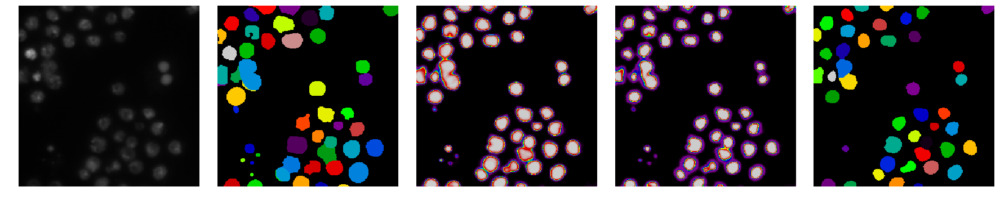

0.8666666666666666 0.579286028852


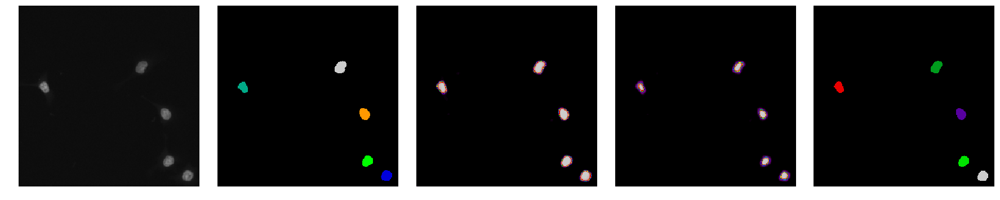

0.7345238095238096 0.631031955743


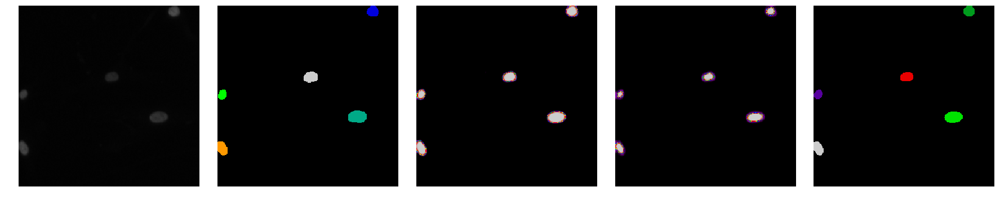

0.46238371773143044 0.58886989624


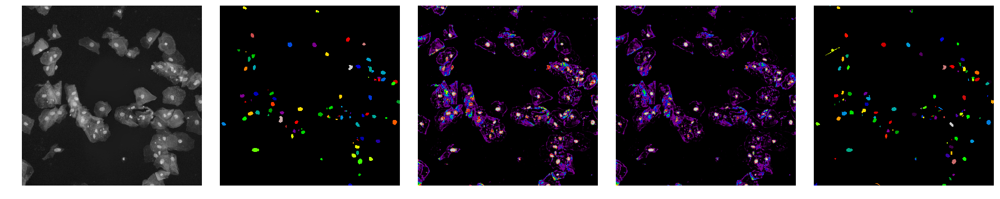

0.7233333333333333 0.615762583659


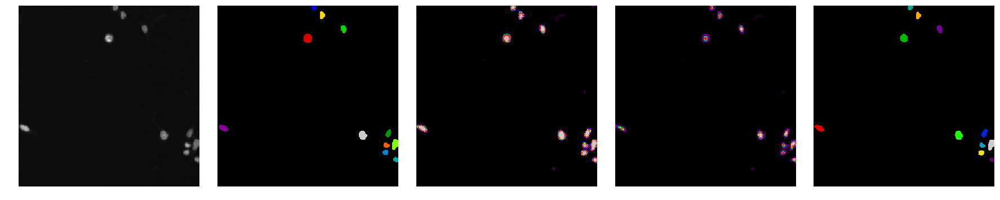

0.8301086956521739 0.651486935658


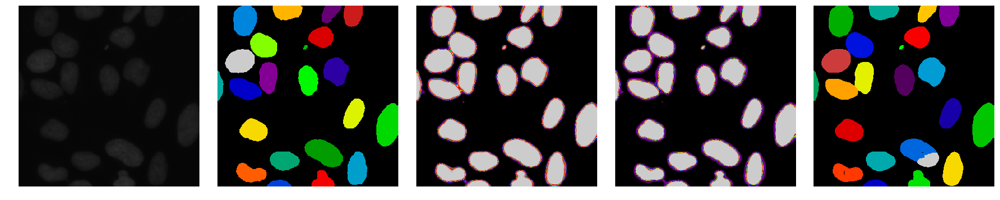

0.3881110987649861 0.613861816102


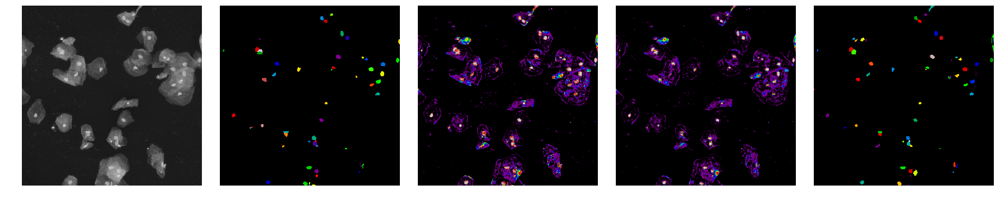

0.7790909090909091 0.634515452725


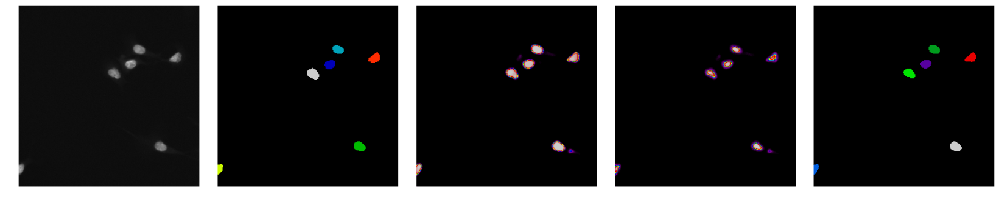

0.272164428082451 0.594254227765


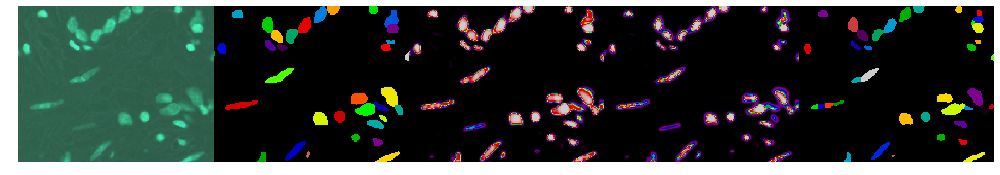

0.8115238095238096 0.615981185941


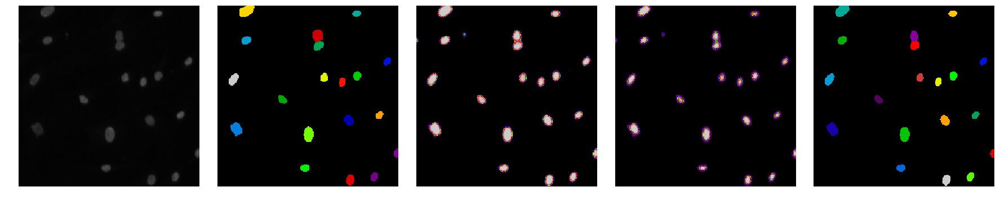

0.08315099715099712 0.567542077869


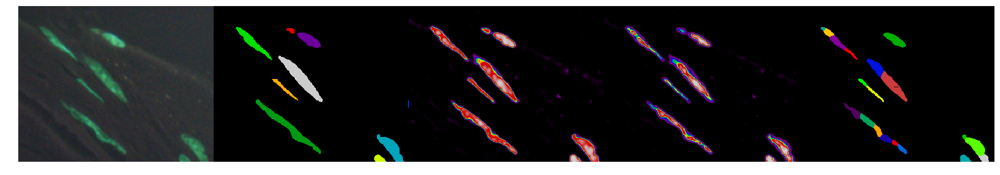

0.7258896916060356 0.580737712347


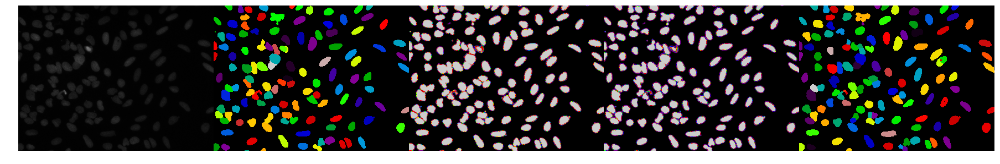

0.9366666666666668 0.608116862679


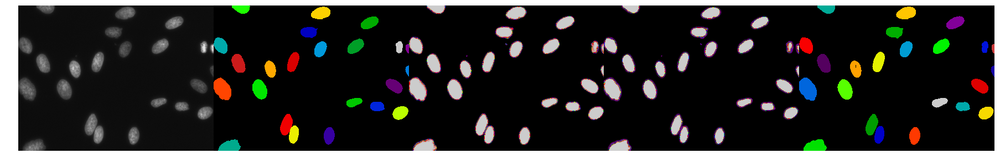

0.4038781094779912 0.593528380308


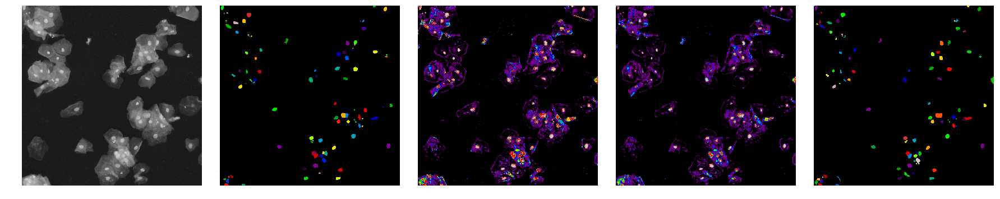

0.5800074493106339 0.592626984908


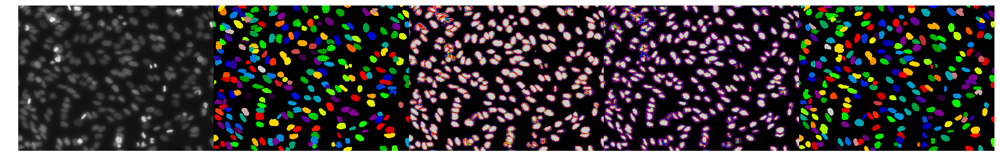

0.16348377315195908 0.565805534173


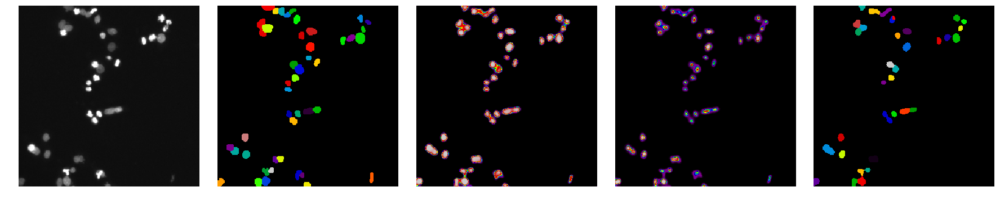

0.5306176767038835 0.563735660204


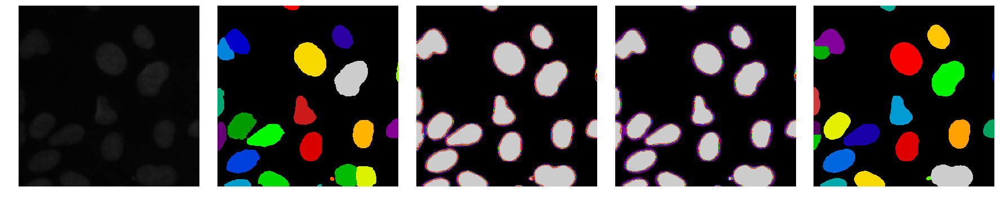

0.11605335405335401 0.538864420974


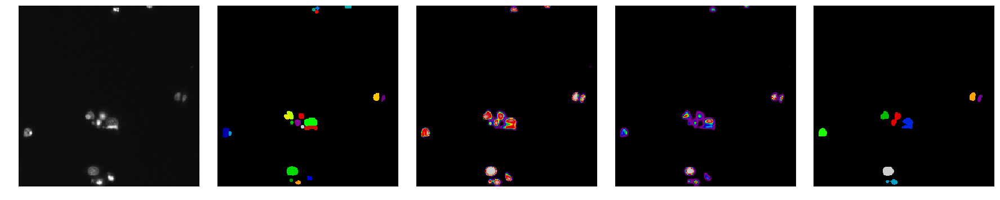

0.20396825396825397 0.521238306921


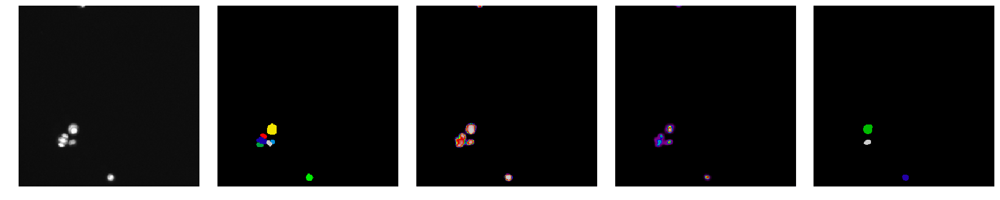

0.5153846153846154 0.520945622344


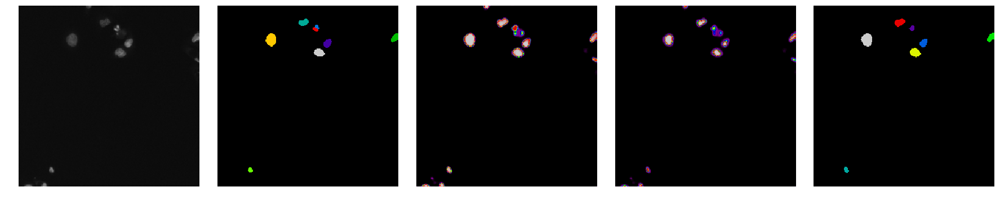

0.49876542797891765 0.519889422612


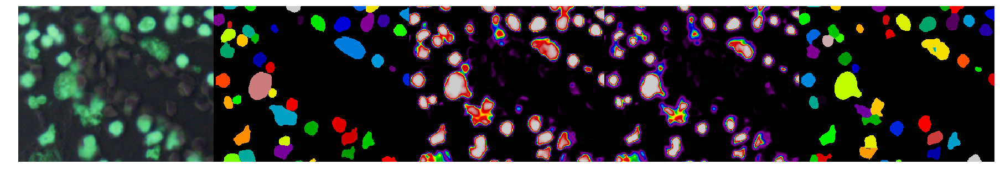

0.7309149184149184 0.529481490603


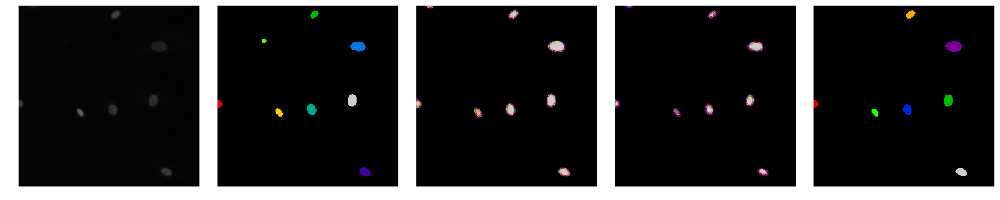

0.21504542009512623 0.515810357103


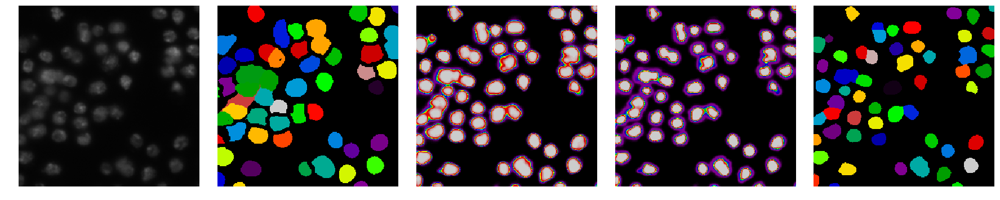

0.6571428571428573 0.521699211271


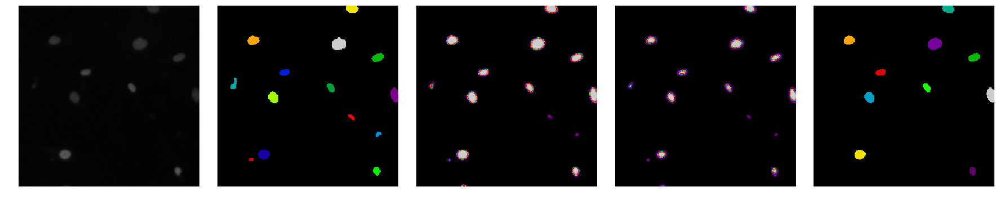

0.859319334140979 0.535204016186


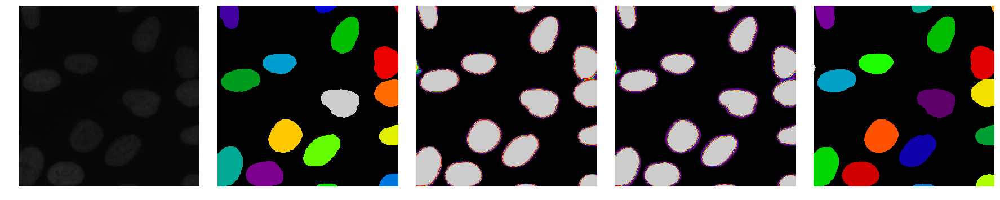

0.6758050889085372 0.540611749752


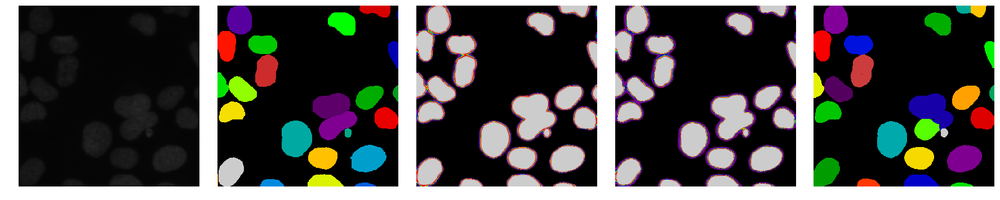

0.6734083544425488 0.545530142519


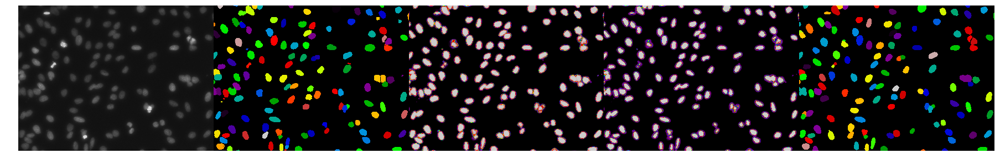

0.36966425076380643 0.539249217813


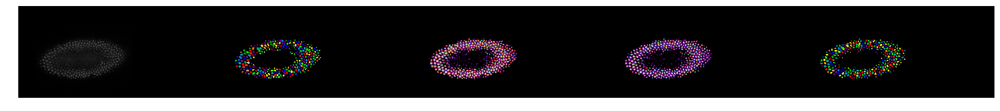

0.28894695000171466 0.53061810513


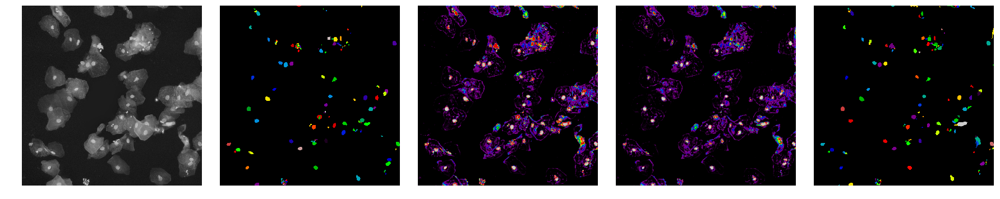

0.8161363636363635 0.540135380414


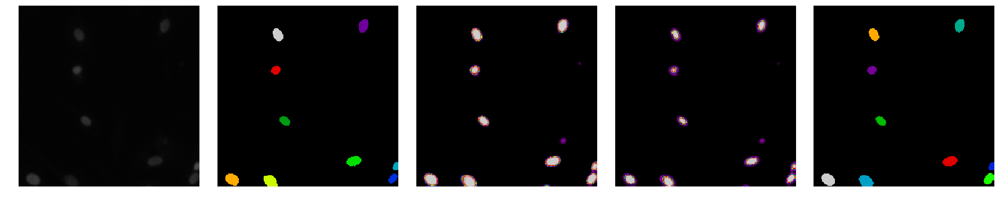

0.6405157342657343 0.543373456344


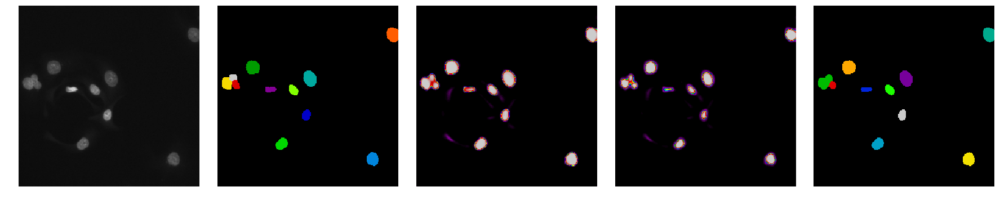

0.21587897731792446 0.533139253875


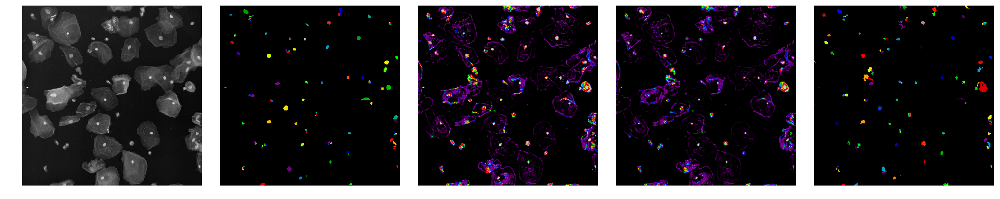

0.7699999999999999 0.540316852242


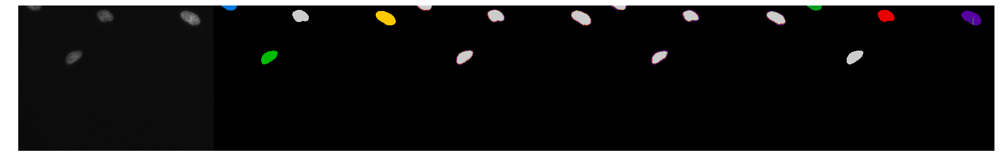

0.5127602345984699 0.539506363488


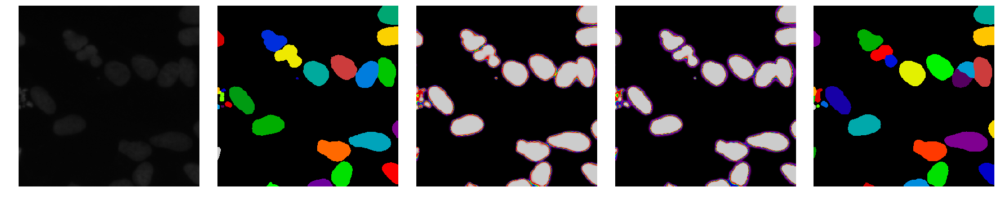

0.3572060872277591 0.534297784166


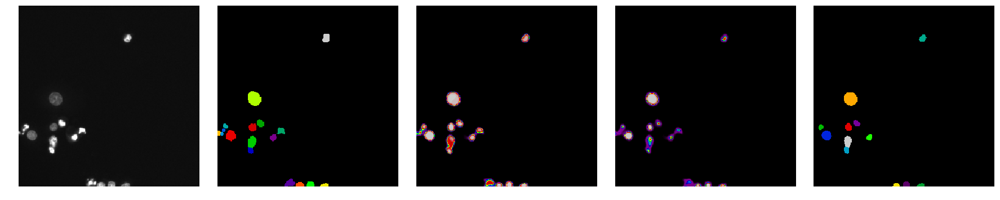

0.7207707443983373 0.539477588617


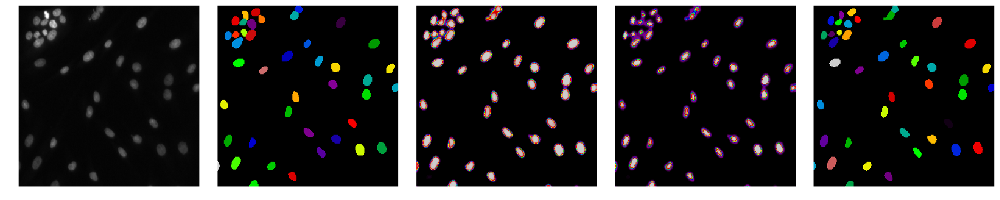

0.6988636363636362 0.543785319637


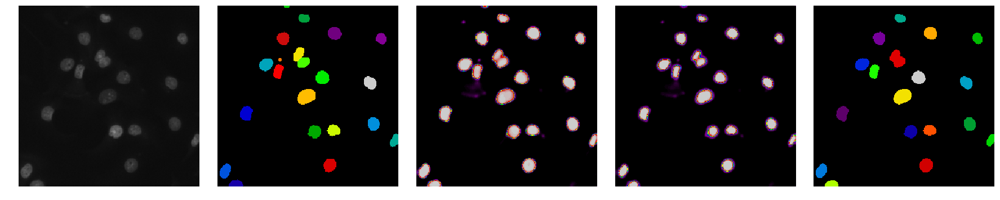

0.8537948028673835 0.551943463933


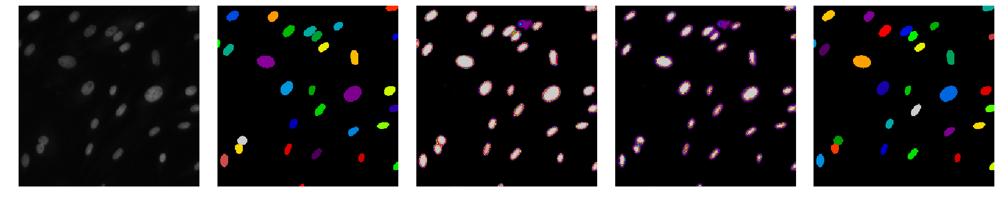

0.6788865664782759 0.55519841528


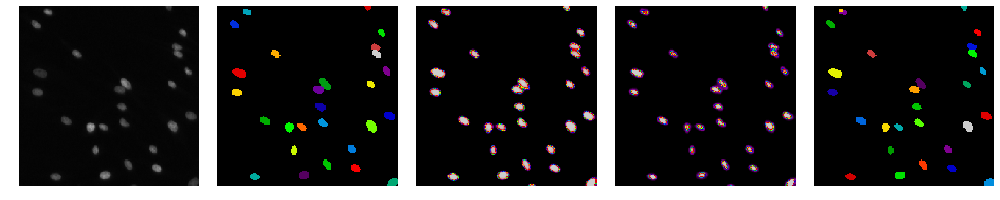

0.33814566072958674 0.549772096416


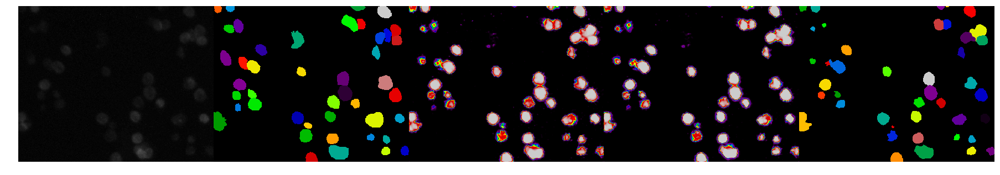

0.555611773716753 0.54991452757


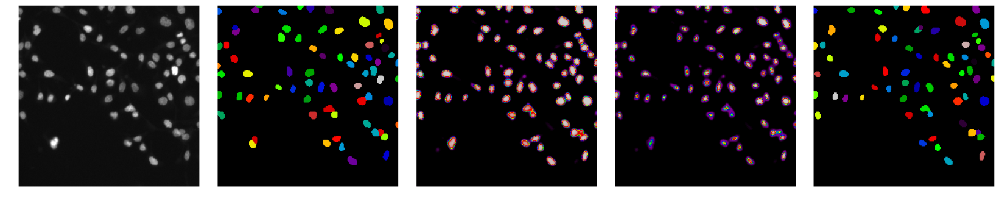

0.8417015550239235 0.556861837748


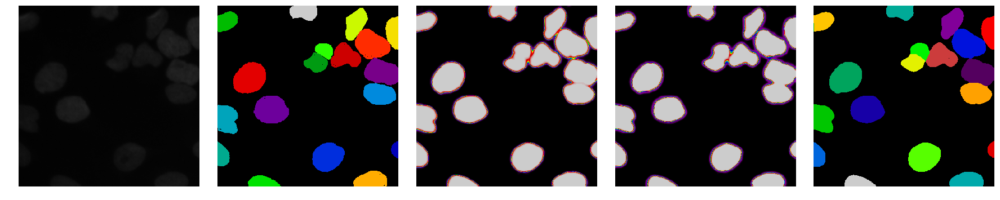

0.6481823157685226 0.558985569795


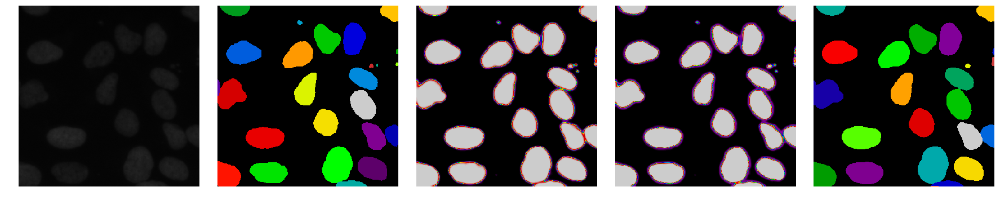

0.9222222222222222 0.567240948259


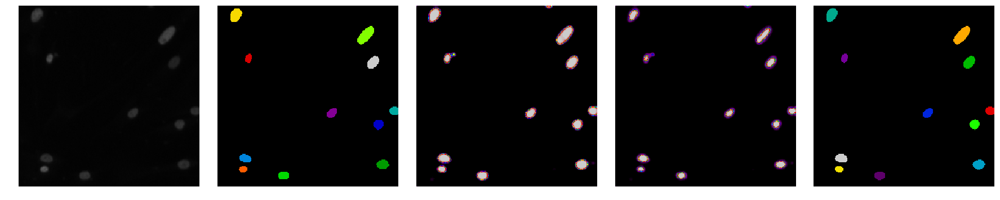

0.9035330261136714 0.574714105544


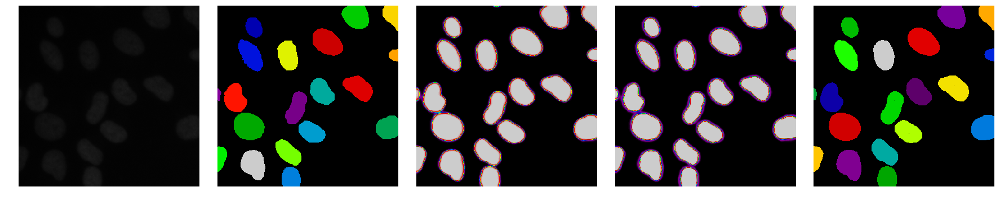

0.7651082251082252 0.578853108144


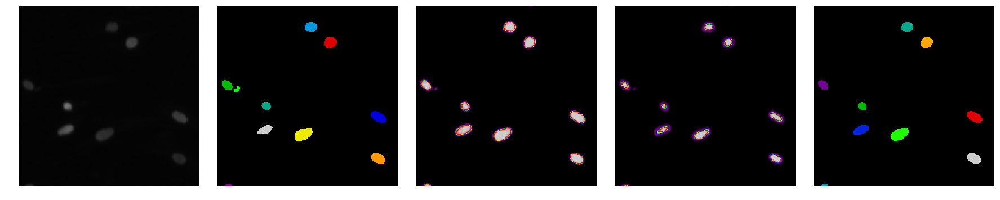

0.9138461538461538 0.585980619754


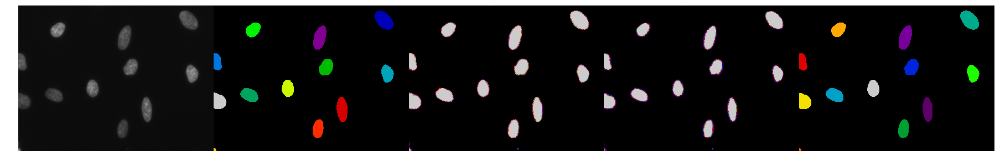

0.3893468335695077 0.581884082542


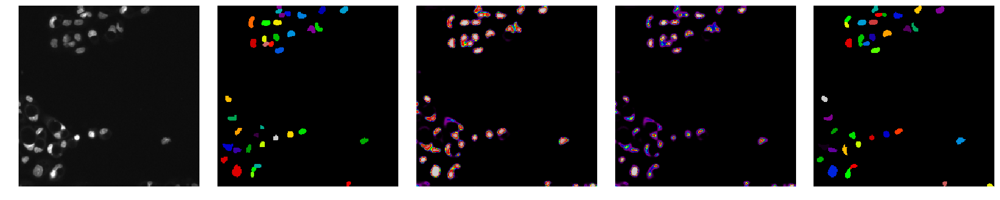

0.28977997371754827 0.575922774199


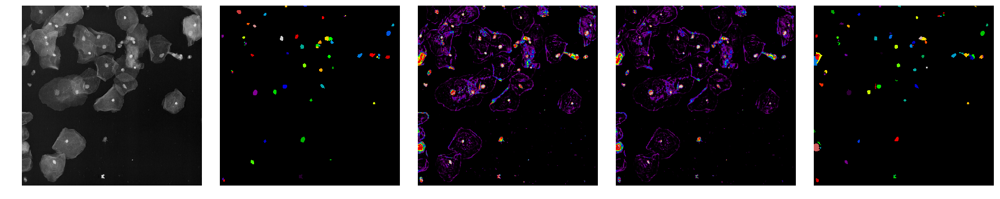

0.5716209036061978 0.575836736787


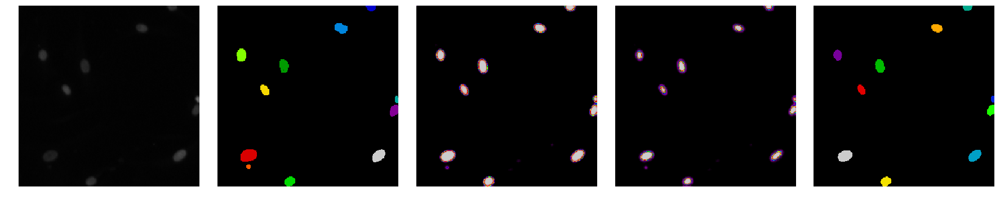

0.775 0.579741898811


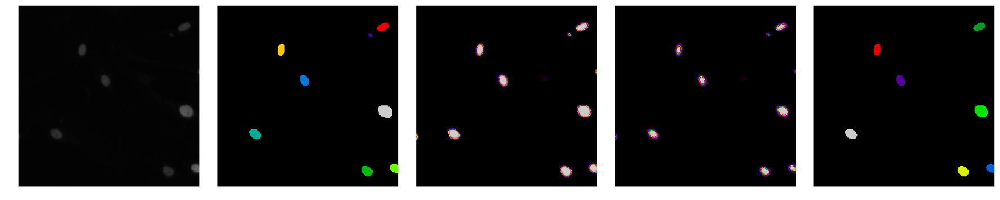

0.8573260073260073 0.585080054744


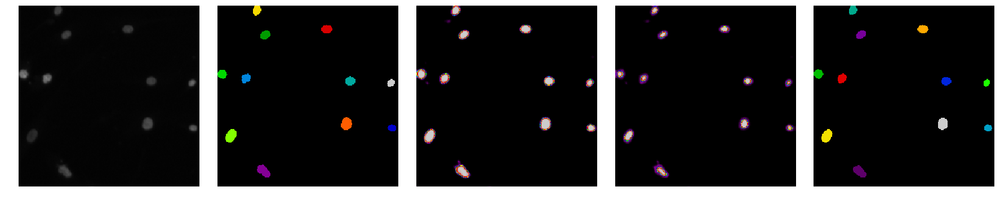

0.1990040648105164 0.577795602103


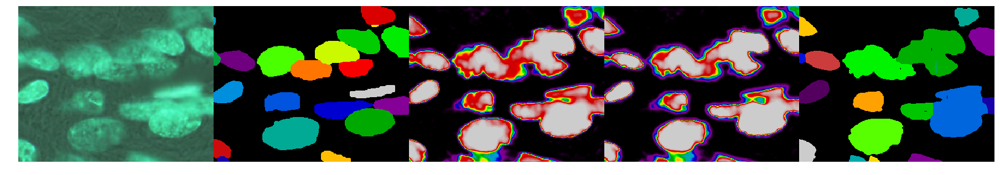

0.40529497275391435 0.574601146004


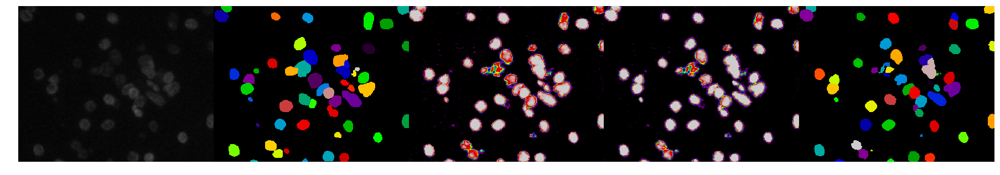

0.26780722036523574 0.569023074629


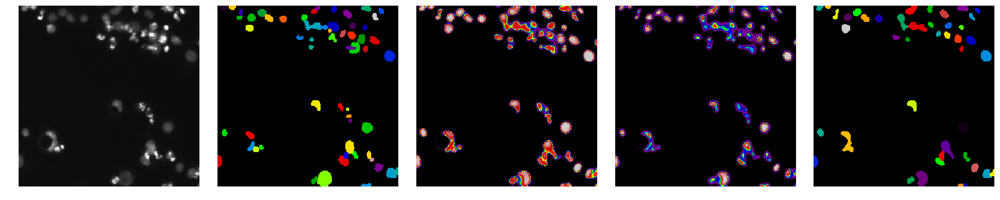

0.27478634069324276 0.563768847237


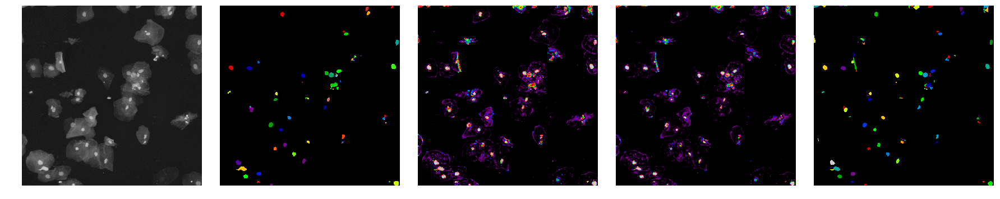

0.4221885751542082 0.561284982815


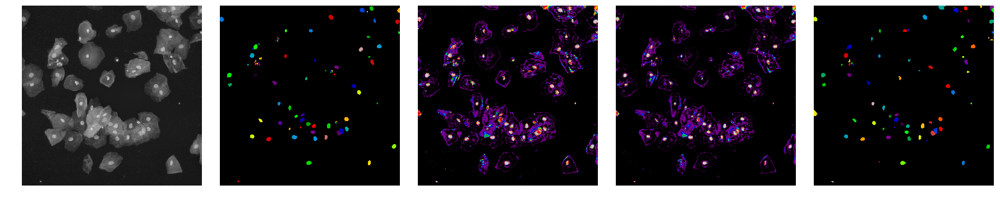

0.5596060559587364 0.5612560358


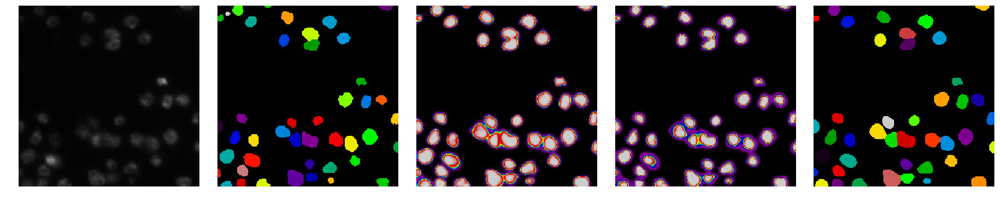

0.6934743224208385 0.563497023709


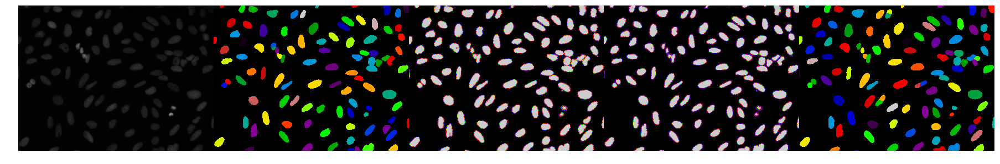

0.8722222222222221 0.568642443684


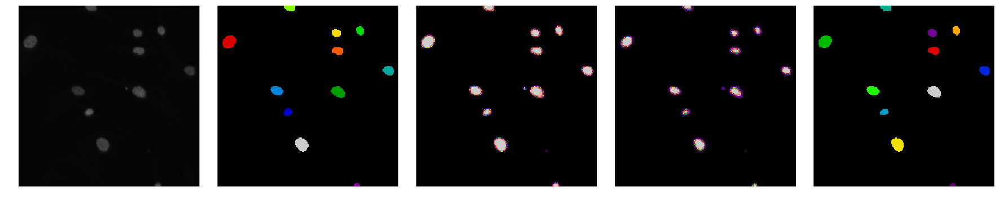

0.7995187165775401 0.572427300617


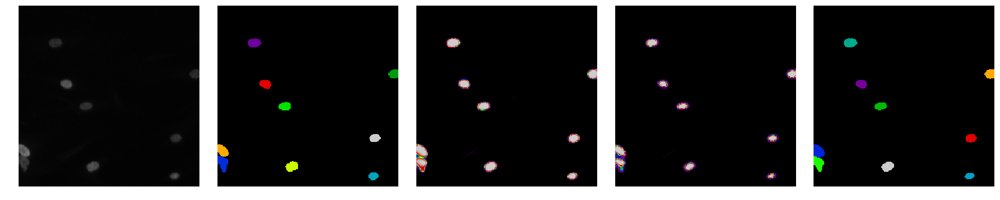

0.34146428326575384 0.56870209066


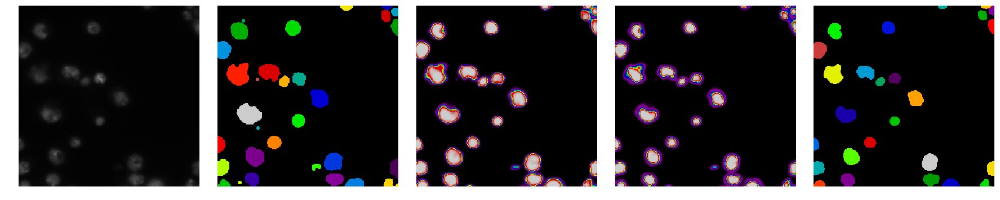

0.5037478813377116 0.567671071464


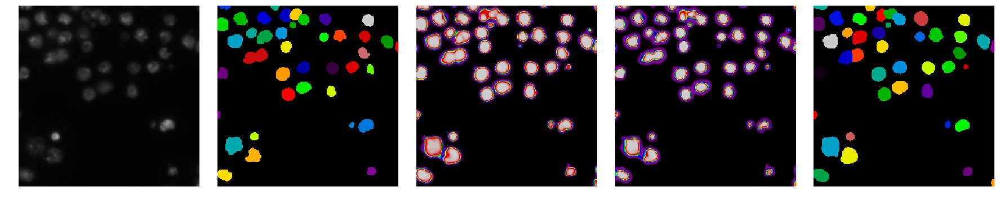

0.25205205811138015 0.56273952438


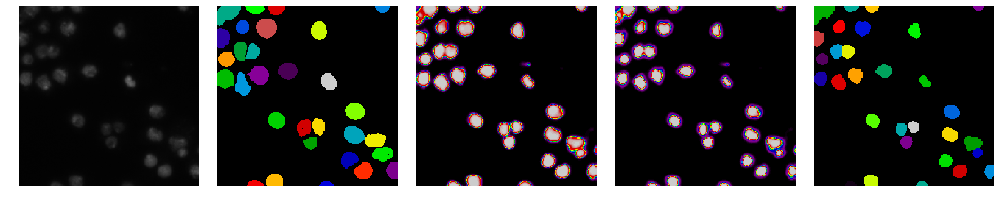

0.40867018673470284 0.560369226878


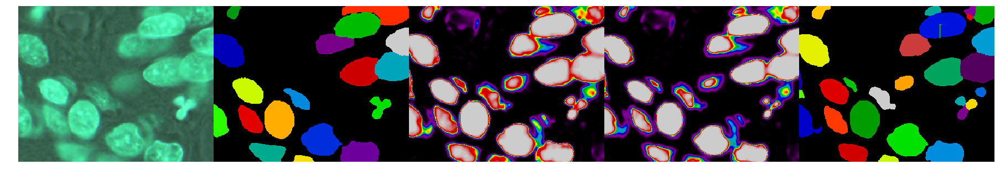

0.7731773399014779 0.563593592227


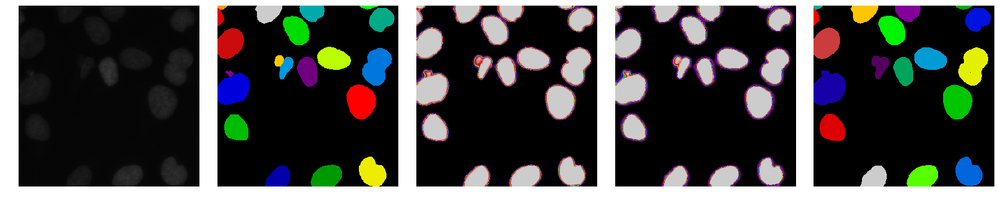

0.3665837392665296 0.56065314666


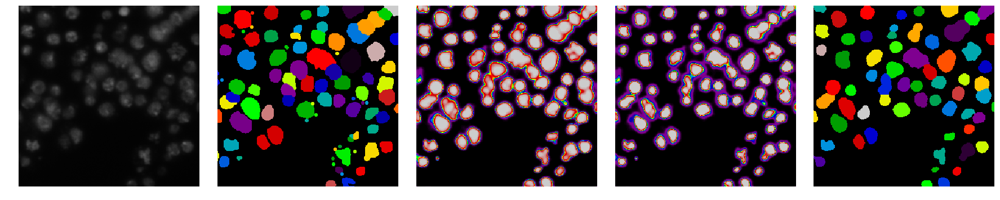

In [346]:
scores = []
for i, (img, pred) in enumerate(zip(val_images, val_predictions)):
    answer = watershed(pred,
        mask_threshold=0.5, center_threshold=0.7, width_holes=4, 
    width_objects=3, sigma=3, padding_size=5, min_size=16, footprint=np.ones((3, 3)))
    scores.append(local_mean_iou(get_labels(val_labels[i]), get_labels(answer)))
    print(scores[-1], np.mean(scores))
    draw.plots([img, val_labels[i], pred[..., 0], pred[..., 2], answer * 12367 % 1000], col_number=5)
    plt.show()

In [347]:
np.mean(scores)

0.56065314666041588

In [363]:
test_transform = transforms.DualCompose(
    [
        transforms.ImageOnly(transforms.Normalize(
            mean=[0.485, 0.456, 0.406],
            std=[0.229, 0.224, 0.225]))
    ]
)

test_predictions, test_names = predict.predict(model, test_ids, "../../data/test/{}.png", test_transform, 1, 2)

Predict: 100%|██████████| 65/65 [00:04<00:00, 15.71it/s]


In [356]:
test_images = []
for _id in tqdm(test_names):
    test_images.append(cv2.imread("../../data/test/{}.png".format(_id)))

100%|██████████| 65/65 [00:00<00:00, 337.35it/s]


0


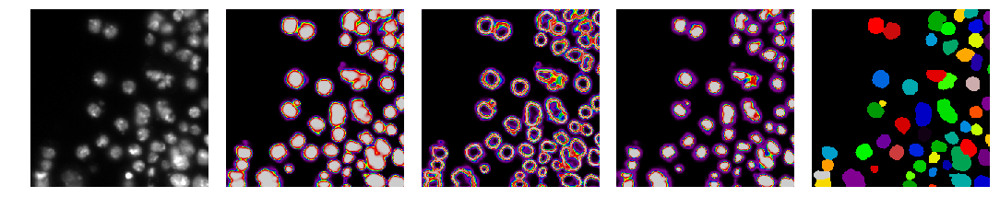

1


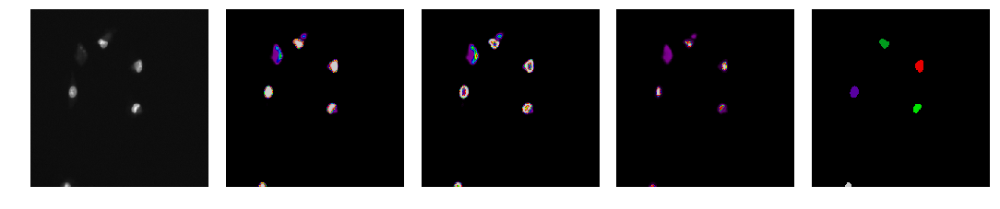

2


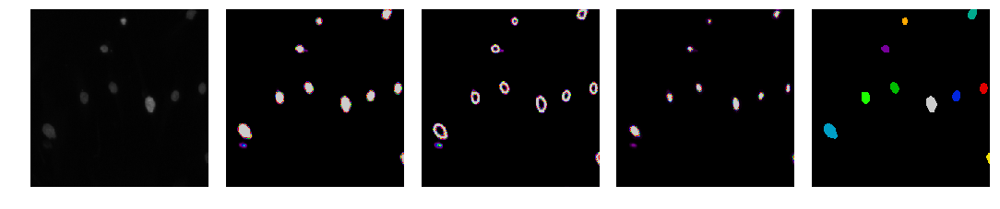

3


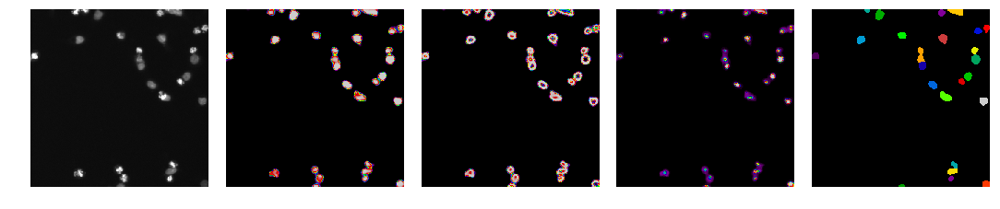

4


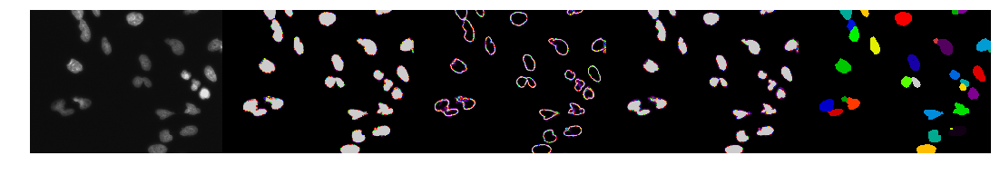

5


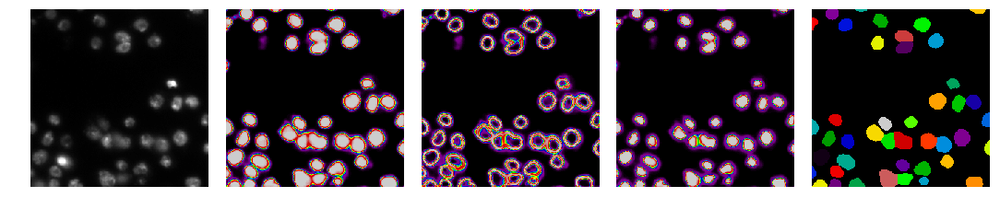

6


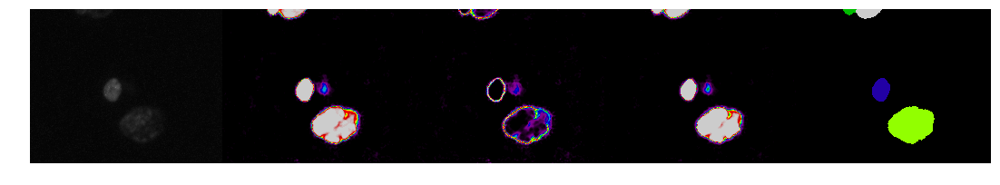

7


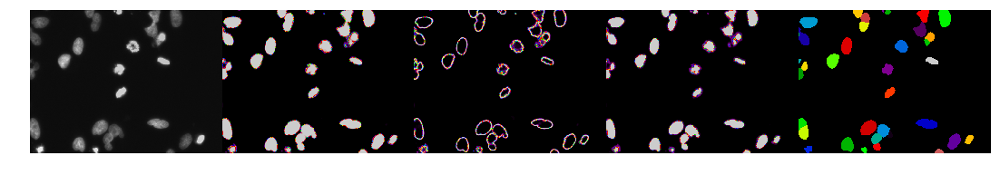

8


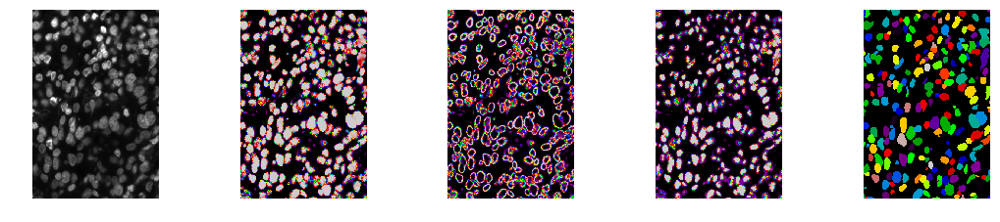

9


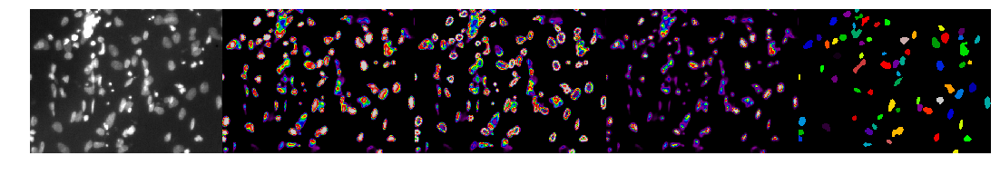

10


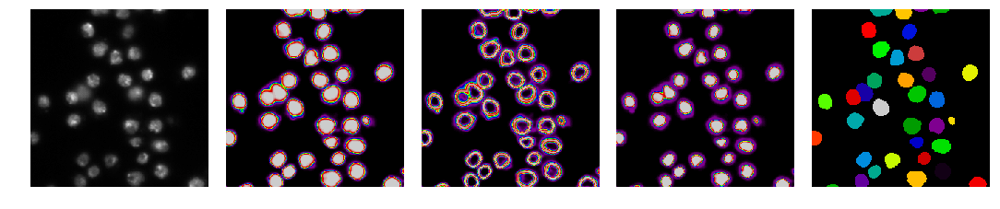

11


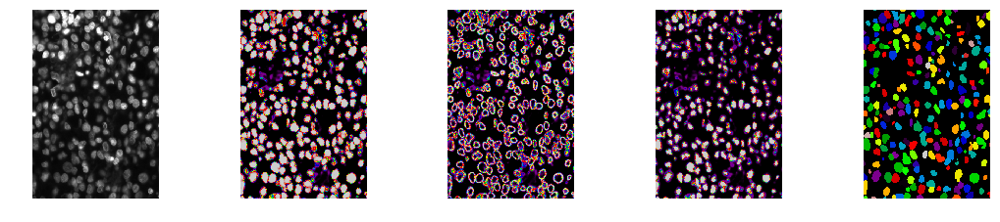

12


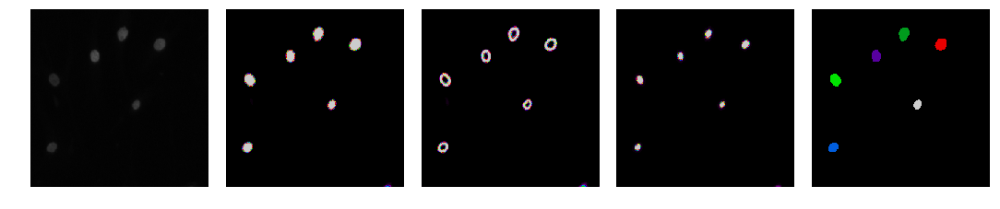

13


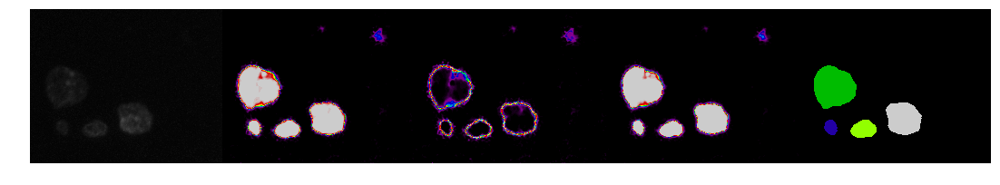

14


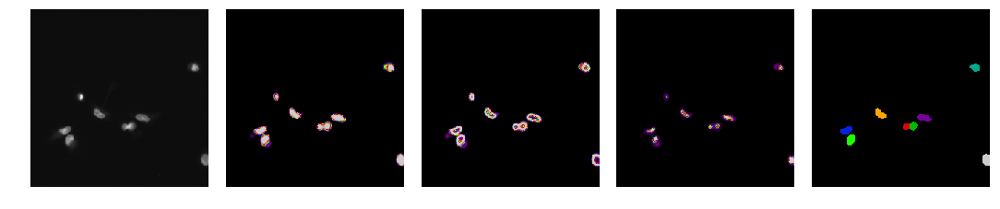

15


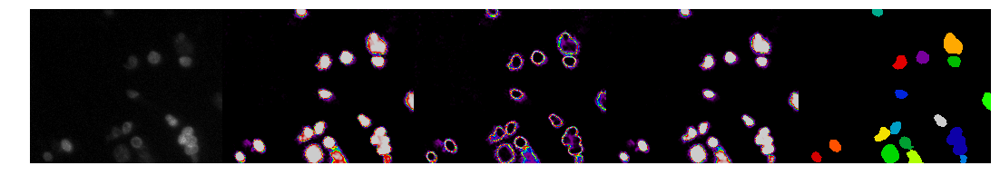

16


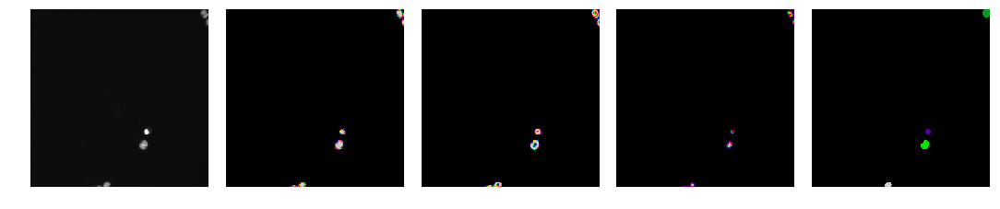

17


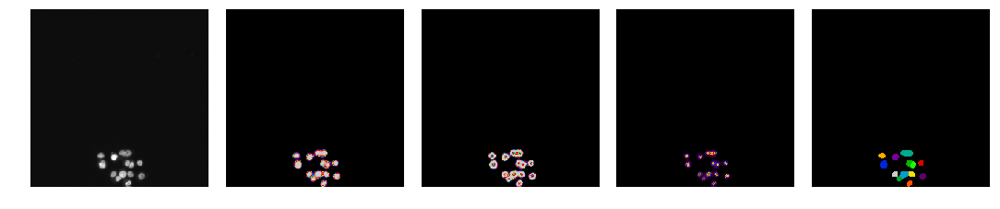

18


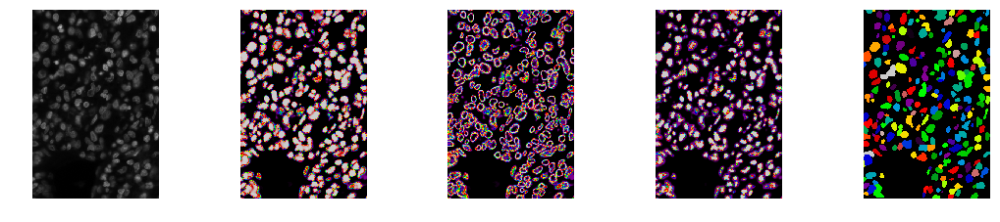

19


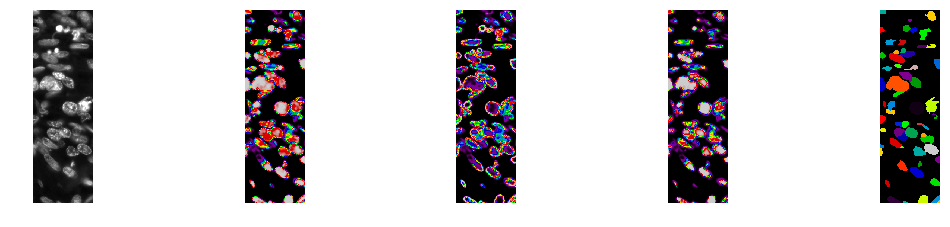

20


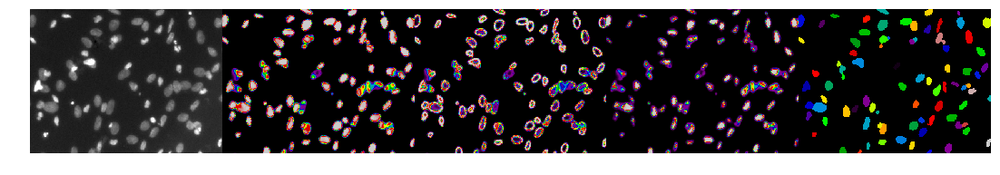

21


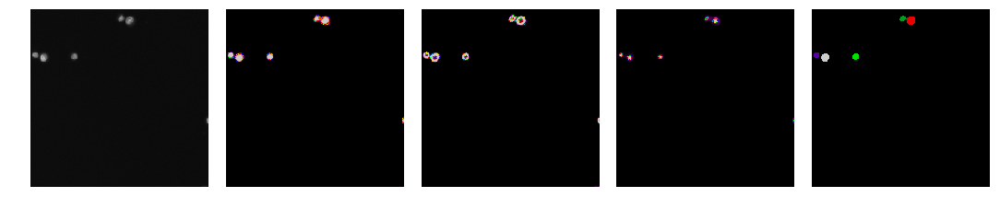

22


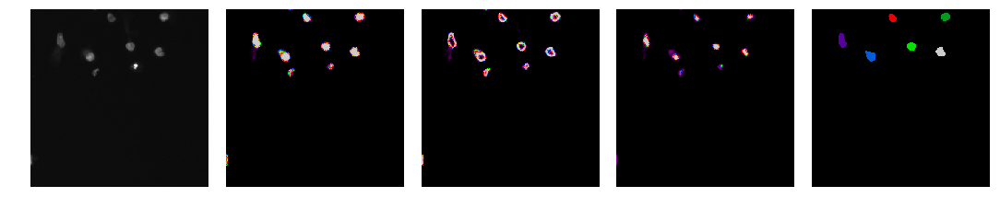

23


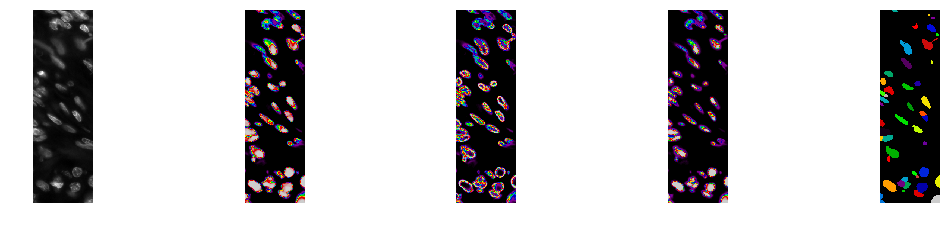

24


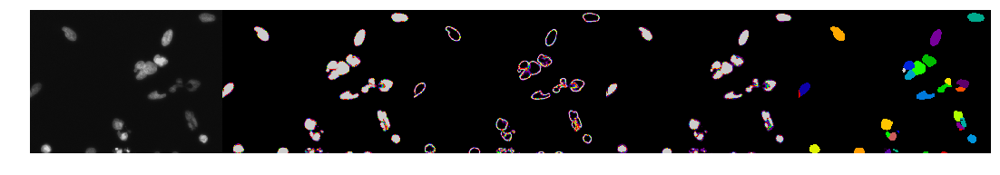

25


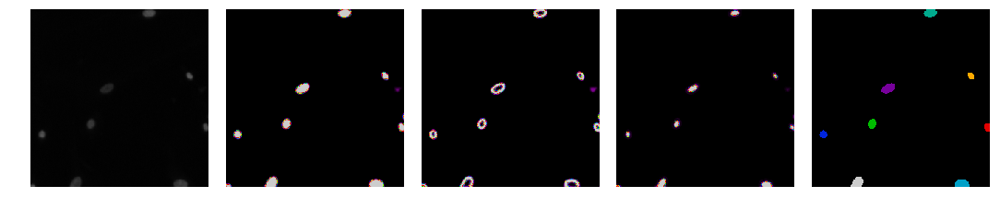

26


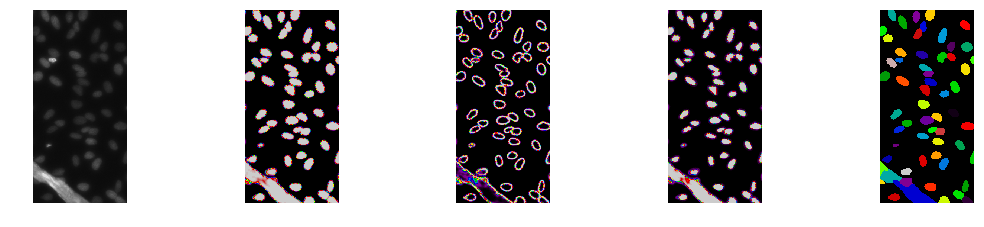

27


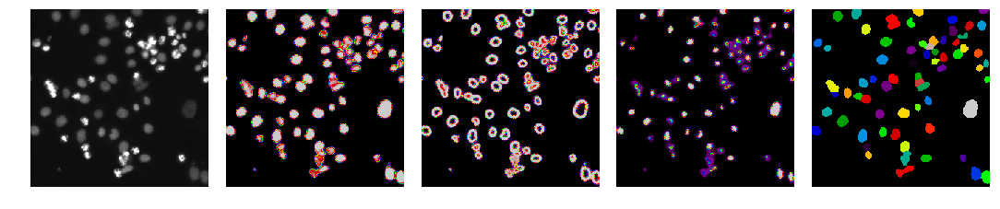

28


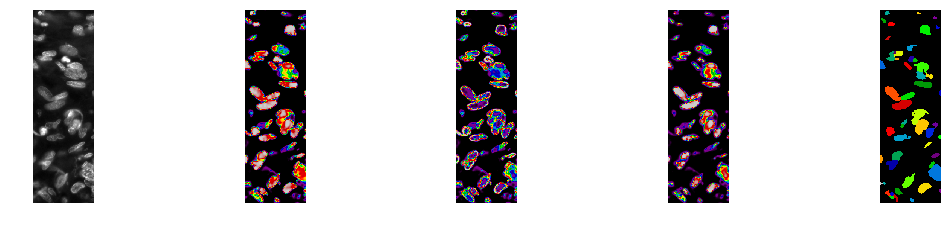

29


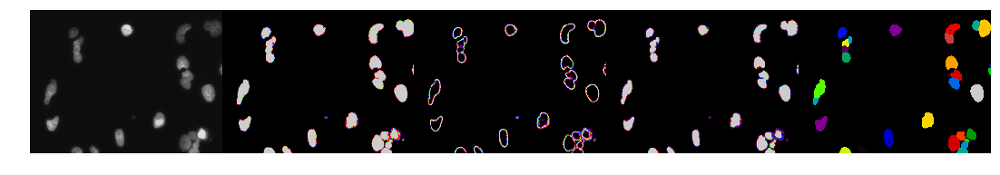

30


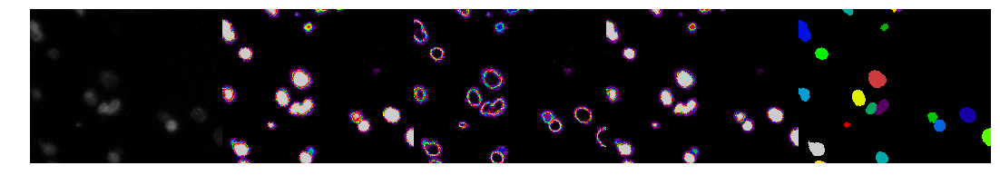

31


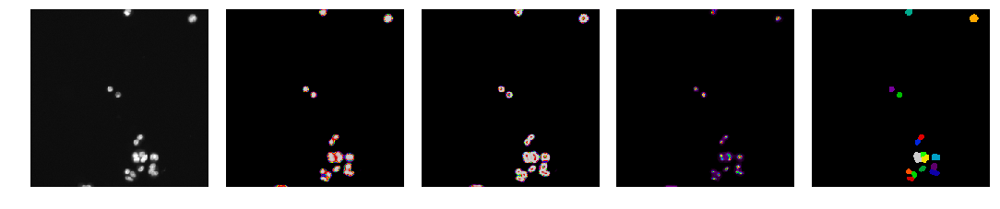

32


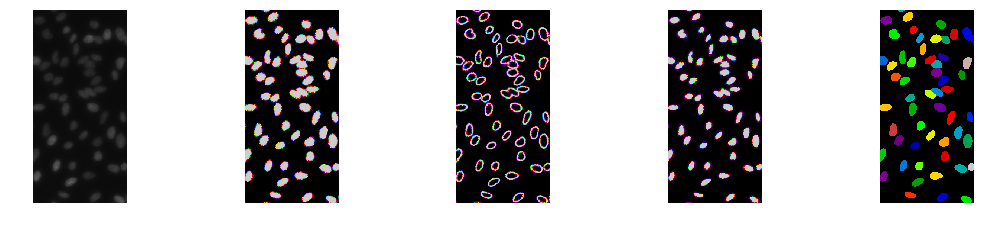

33


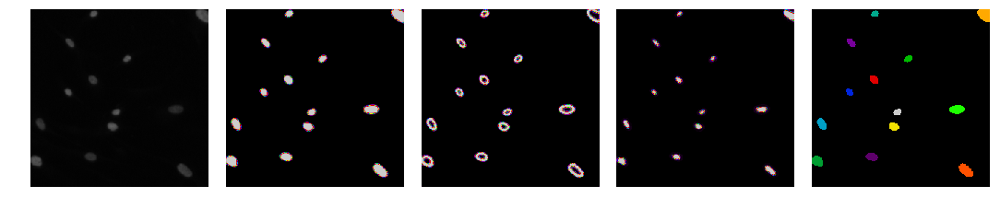

34


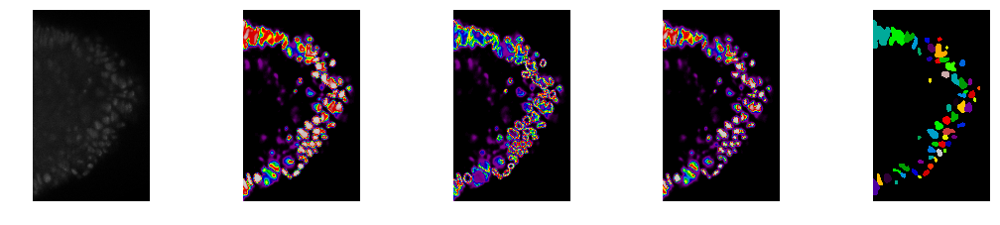

35


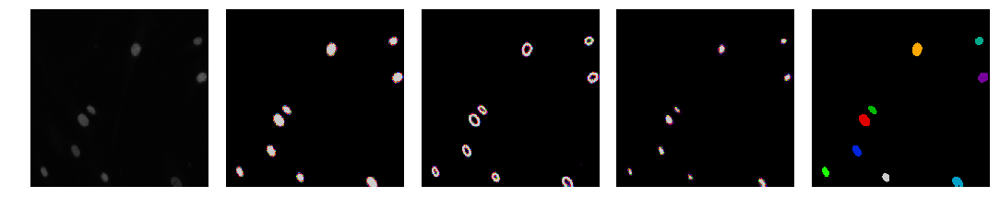

36


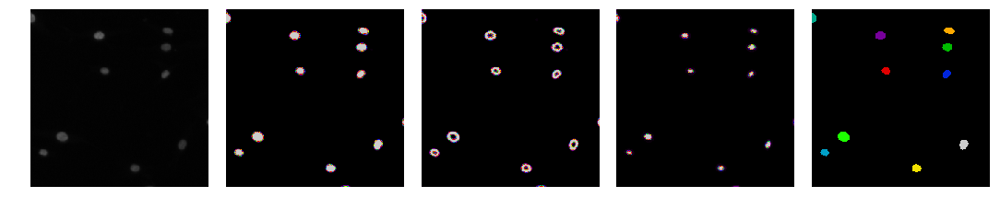

37


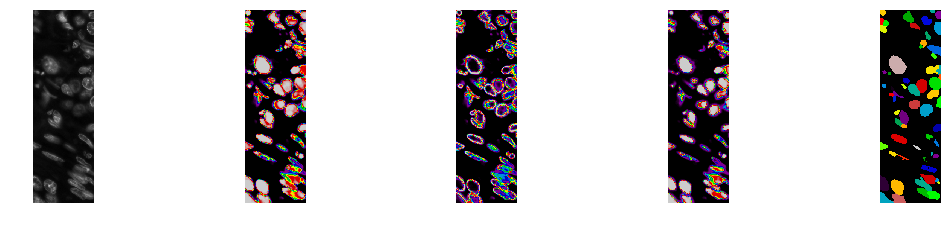

38


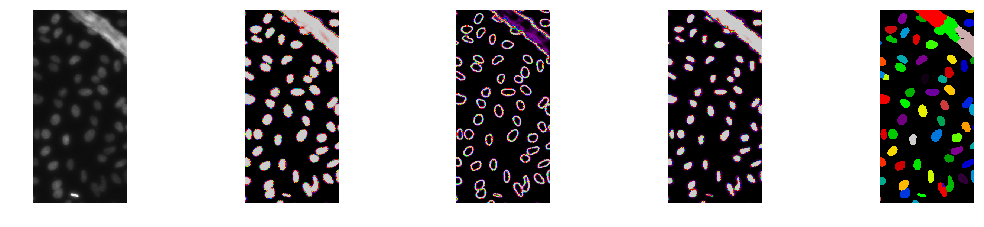

39


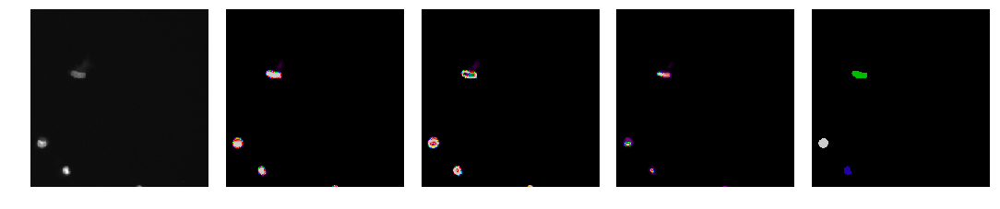

40


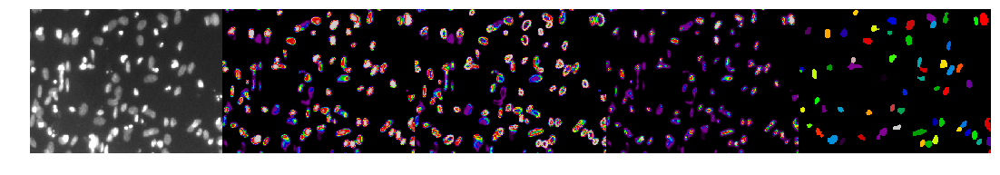

41


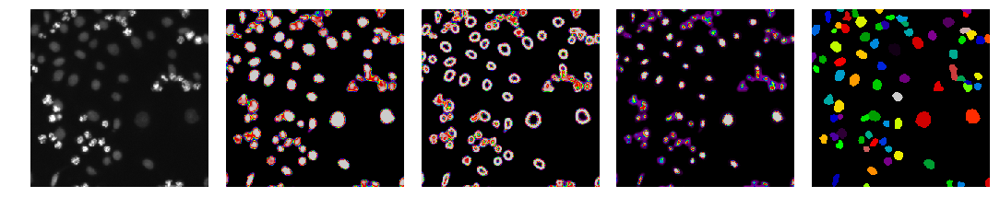

42


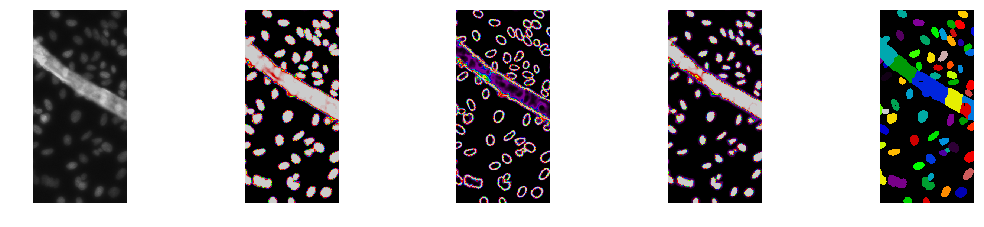

43


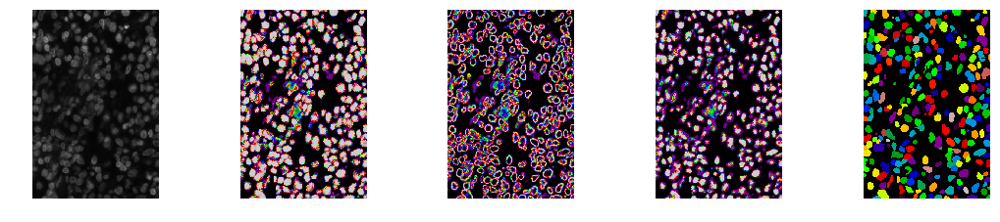

44


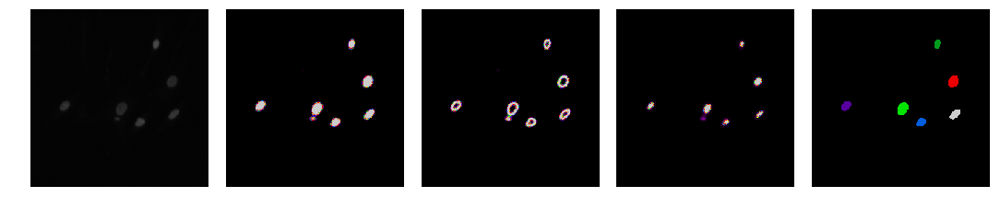

45


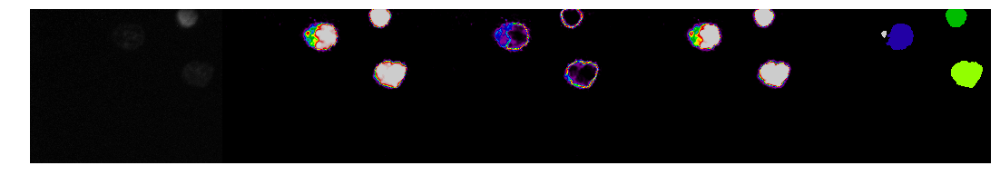

46


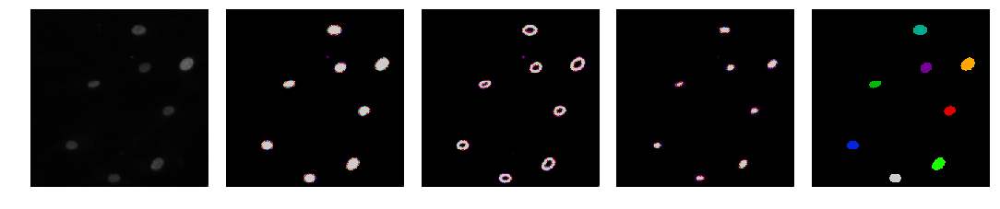

47


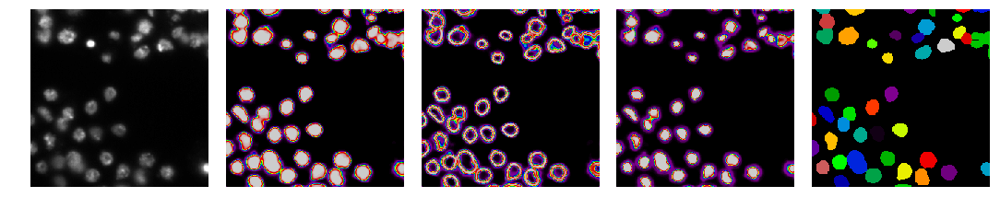

48


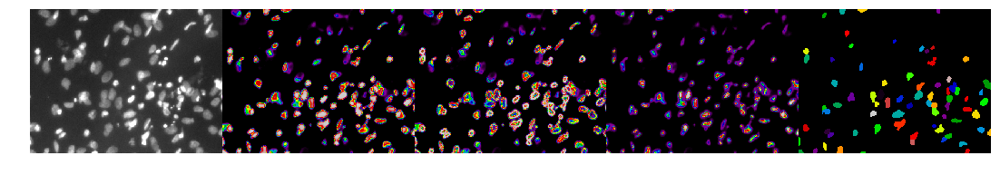

49


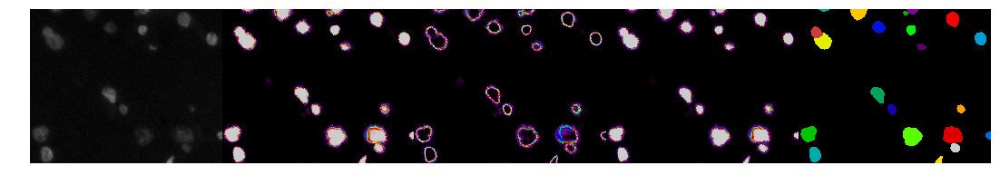

50


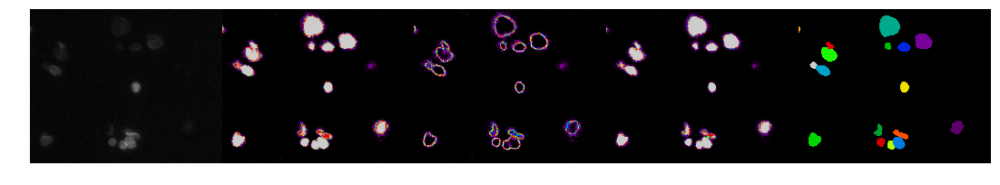

51


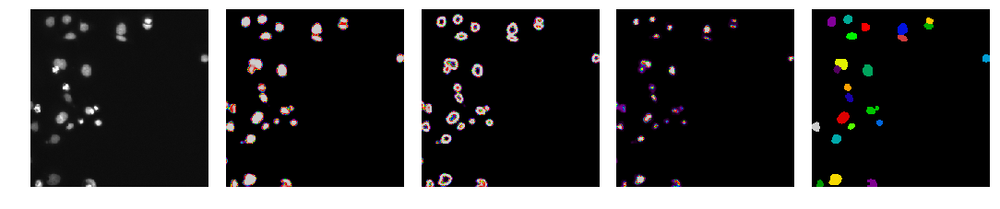

52


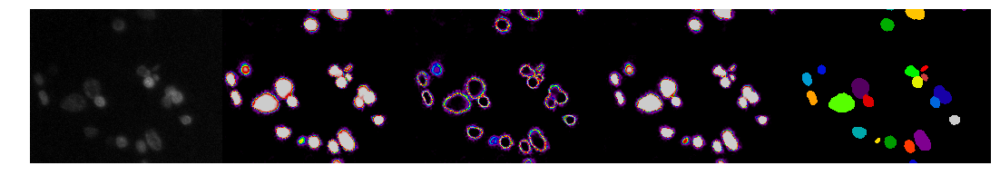

53


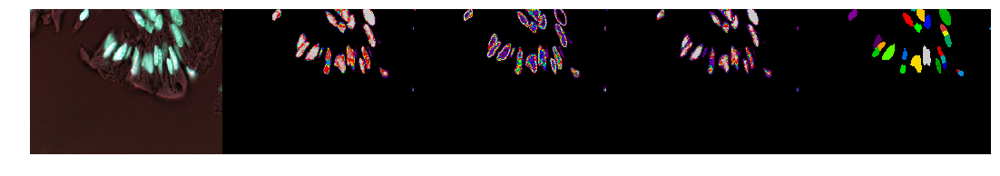

54


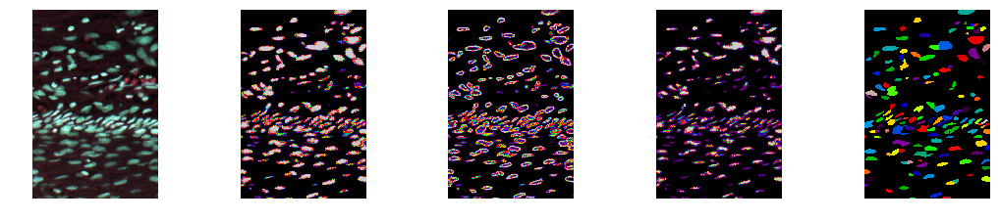

55


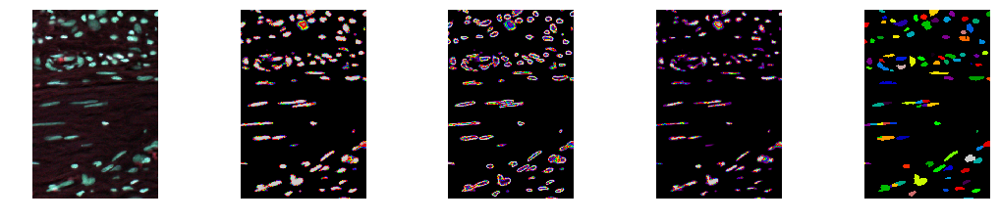

56


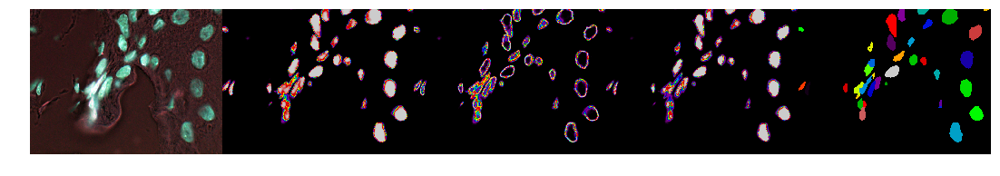

57


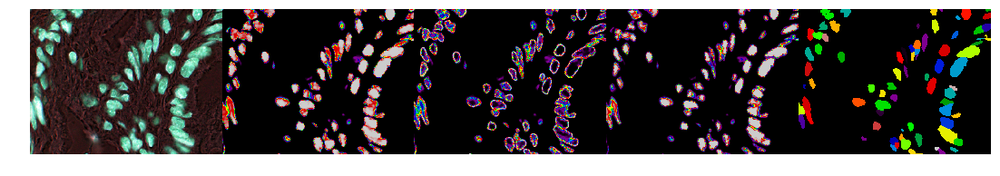

58


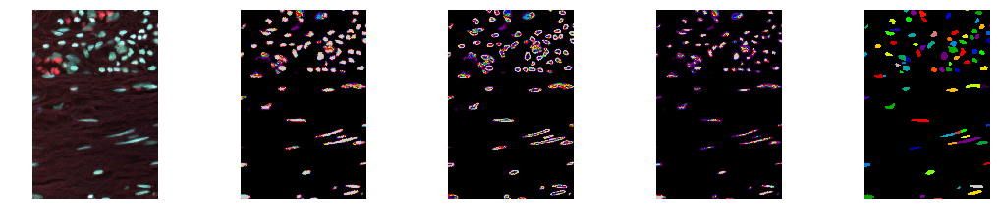

59


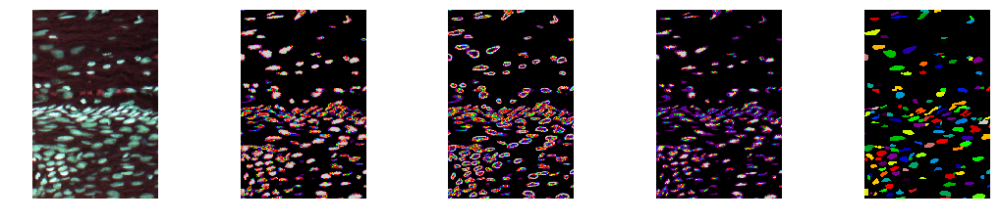

60


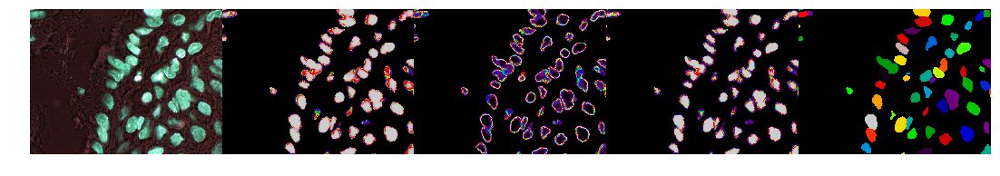

61


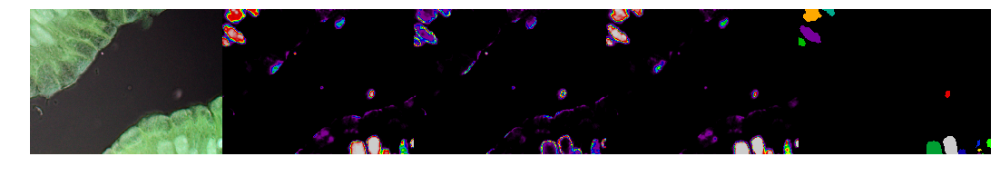

62


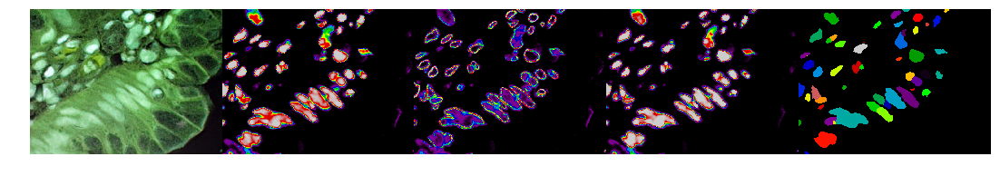

63


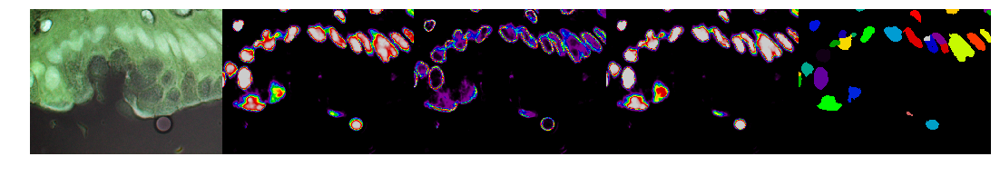

64


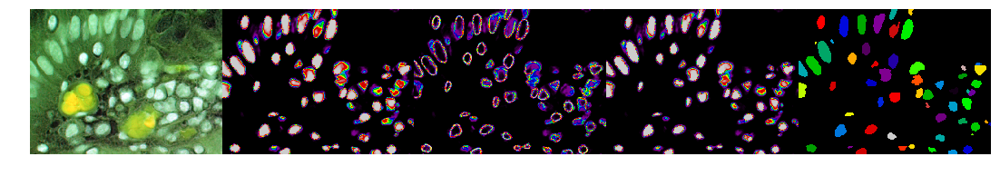

In [364]:
for i in range(len(test_images)):
    print(i)
    draw.plots([
      test_images[i],
      test_predictions[i][..., 0], 
      test_predictions[i][..., 1],
      test_predictions[i][..., 2],
      watershed(
        test_predictions[i], mask_threshold=0.5, center_threshold=0.7, width_holes=4, 
    width_objects=3, sigma=3, padding_size=5, min_size=16, footprint=np.ones((3, 3))
    ) * 12367 % 1000,
    ], scale=3, col_number=5)
    plt.show()

0


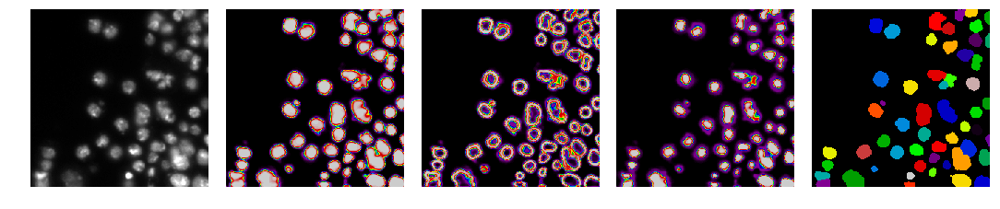

1


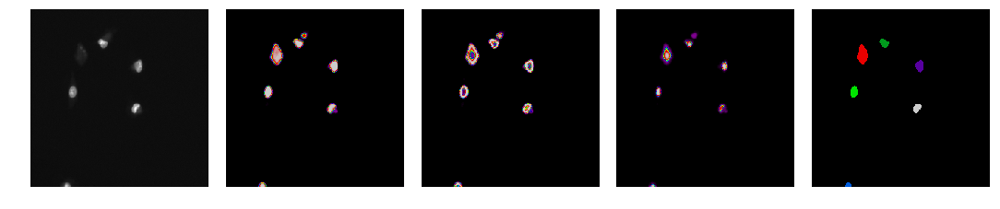

2


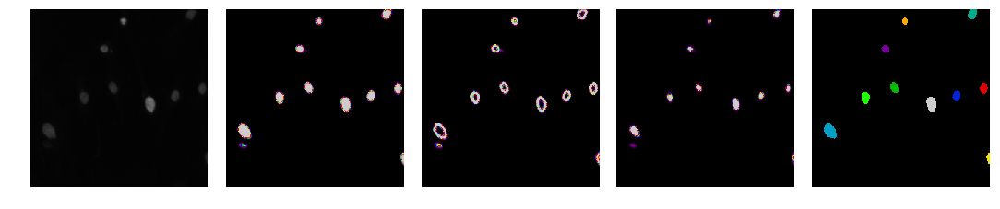

3


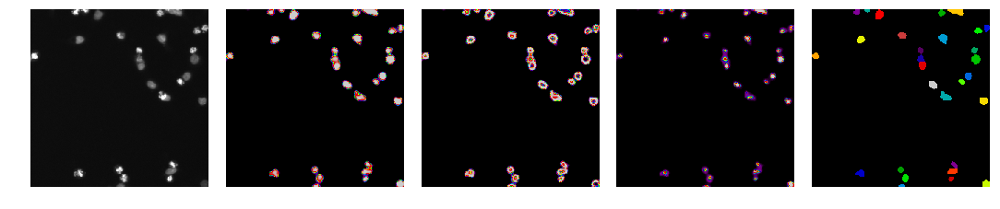

4


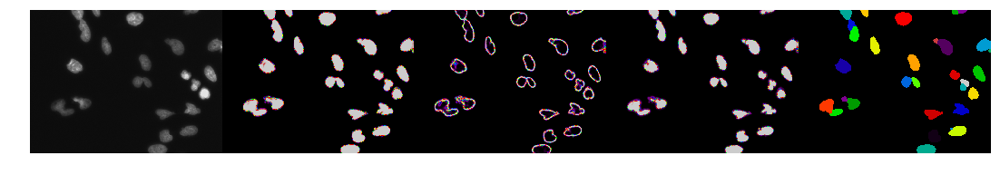

5


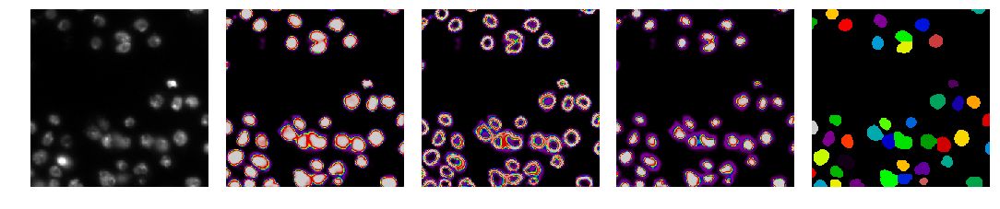

6


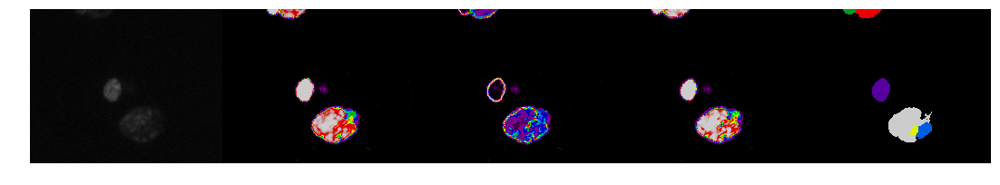

7


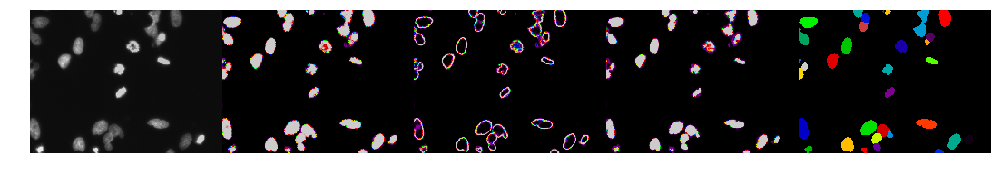

8


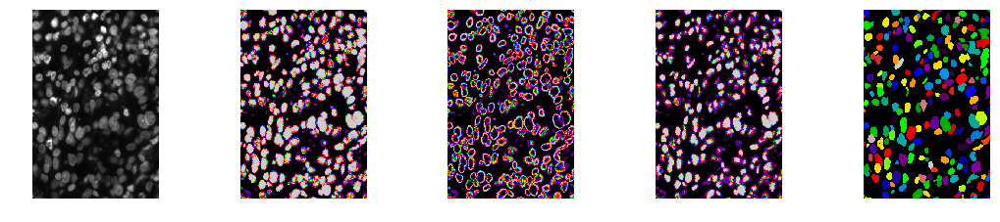

9


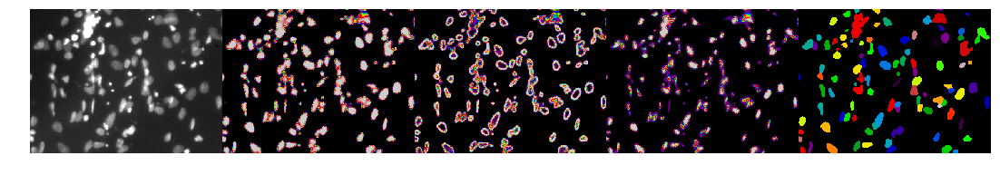

10


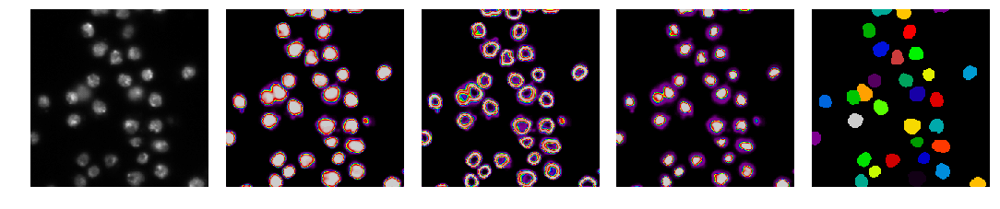

11


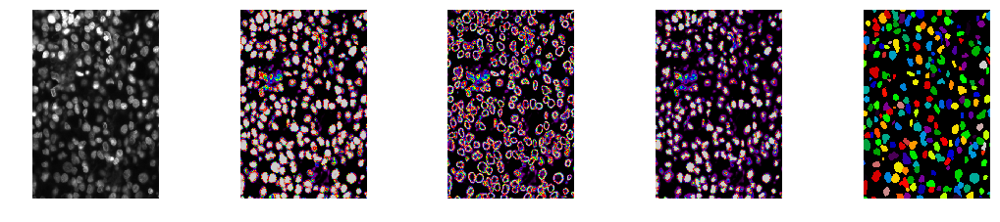

12


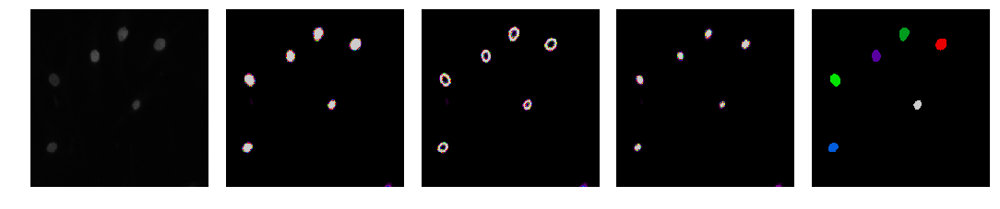

13


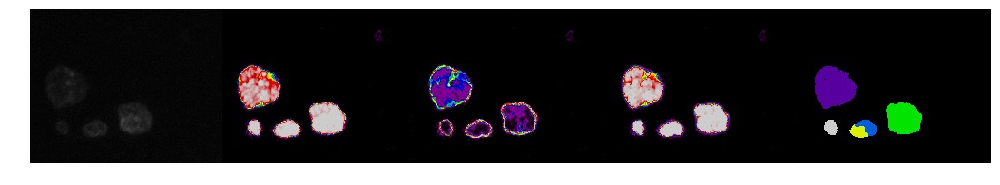

14


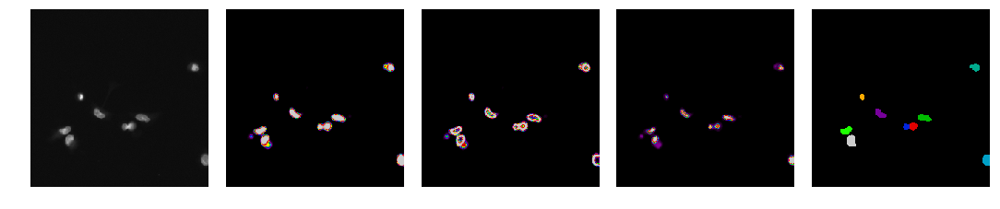

15


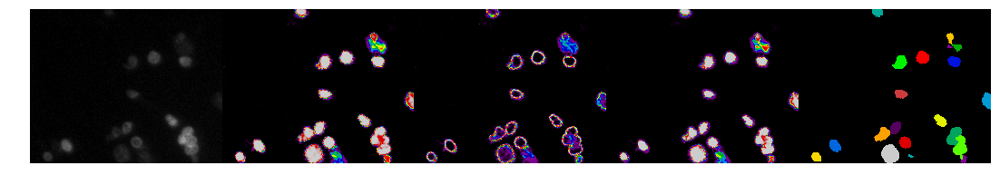

16


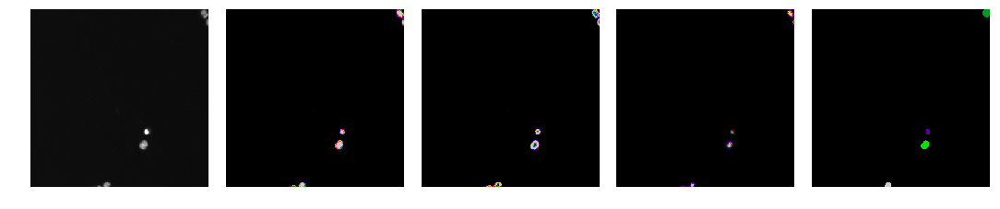

17


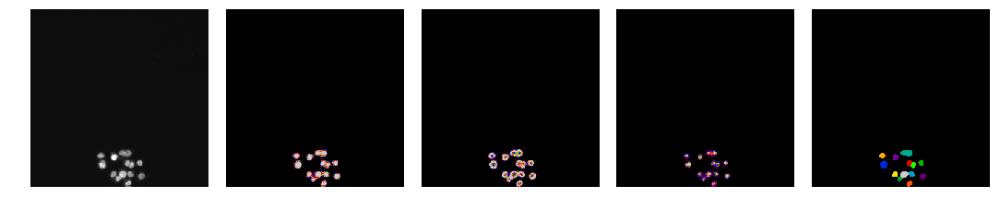

18


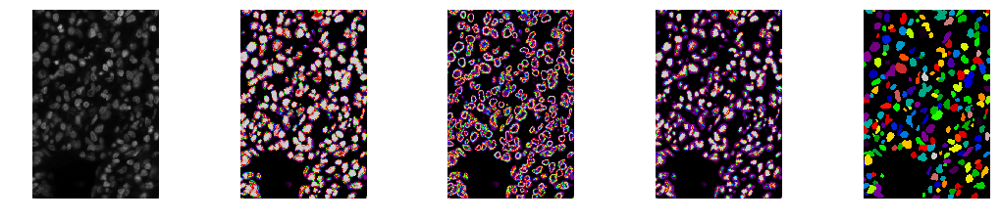

19


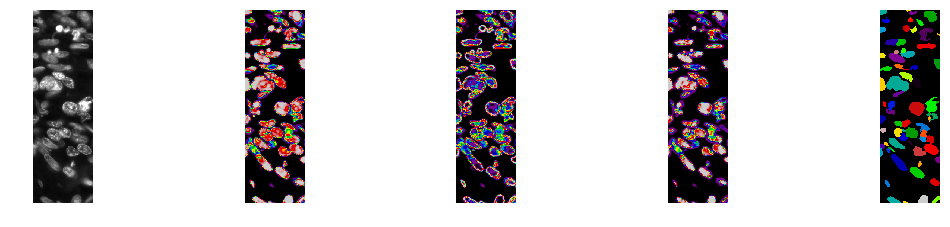

20


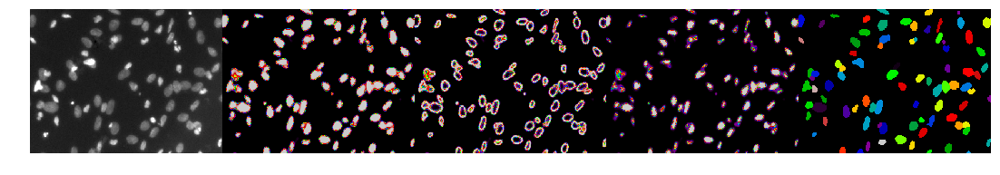

21


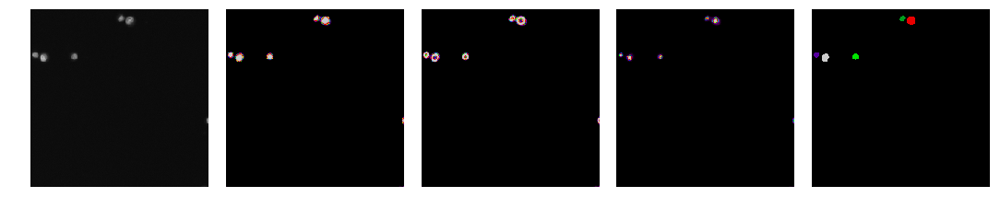

22


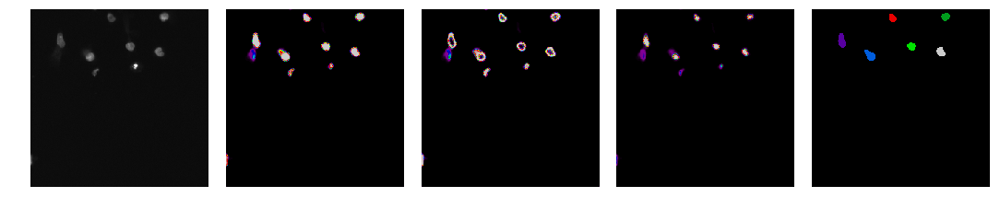

23


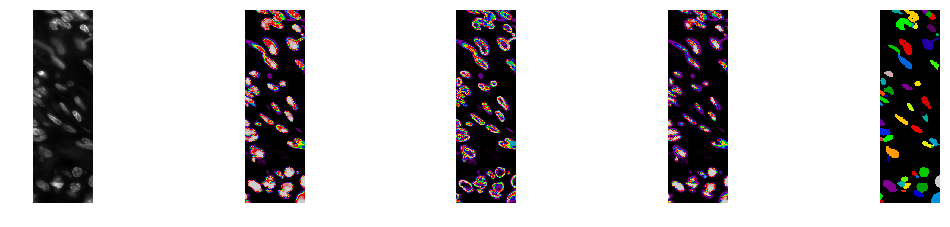

24


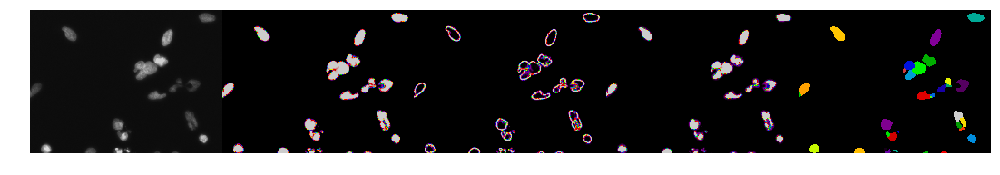

25


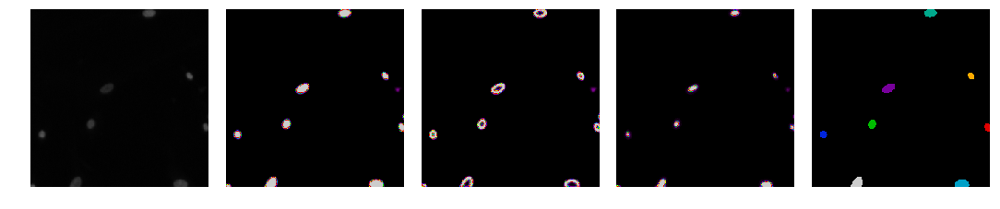

26


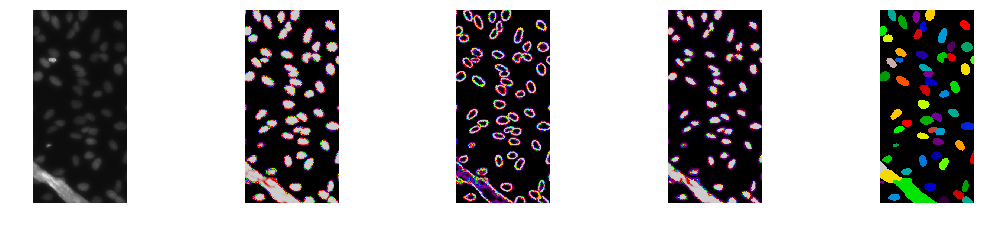

27


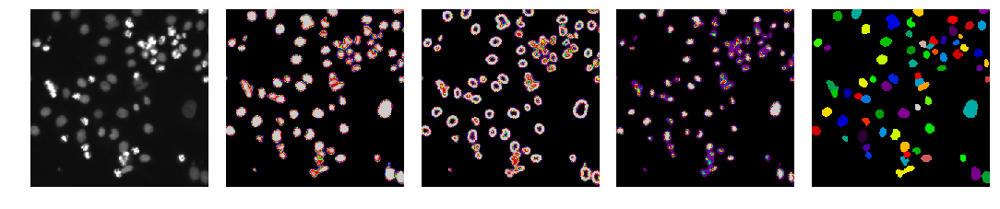

28


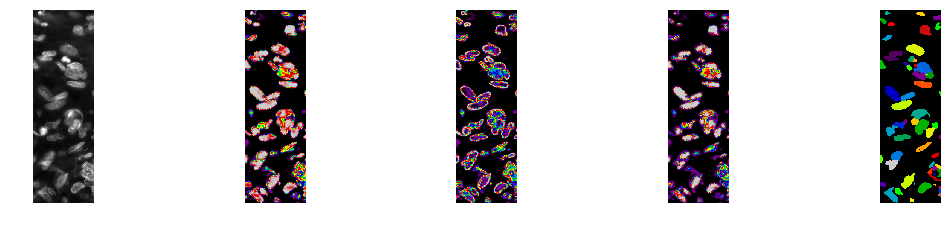

29


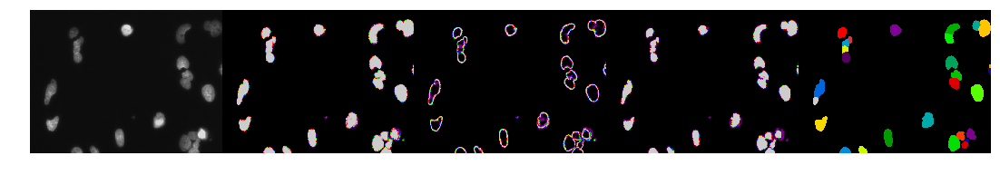

30


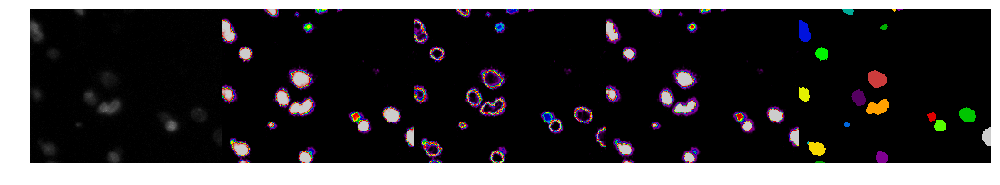

31


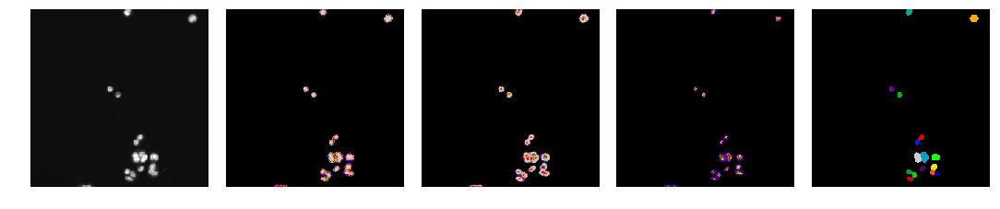

32


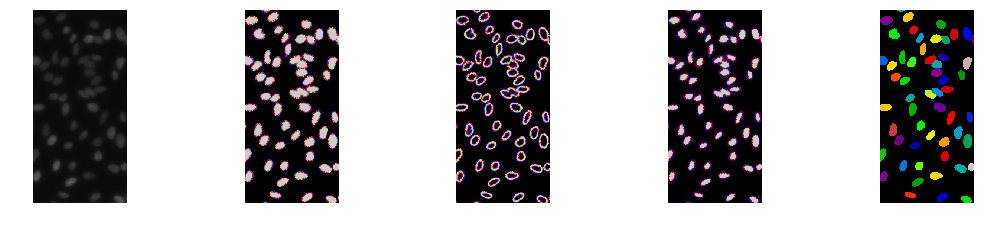

33


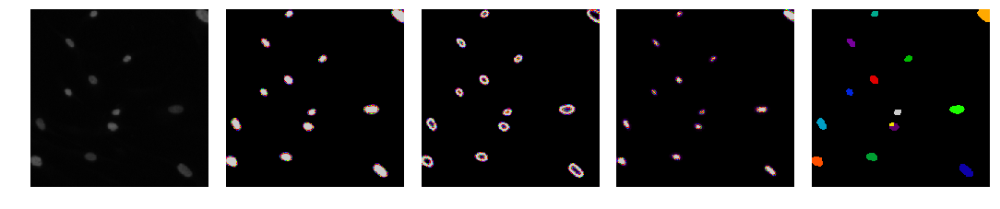

34


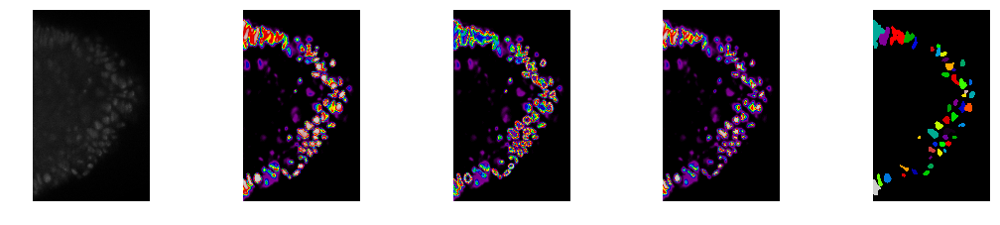

35


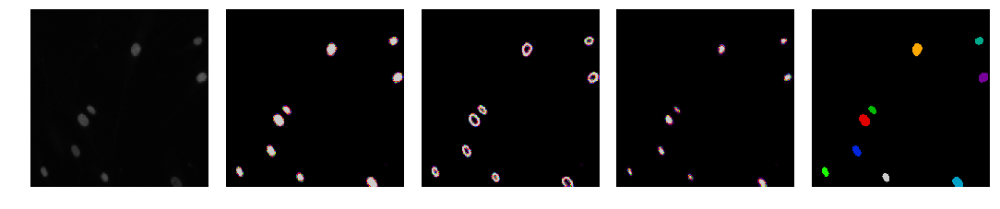

36


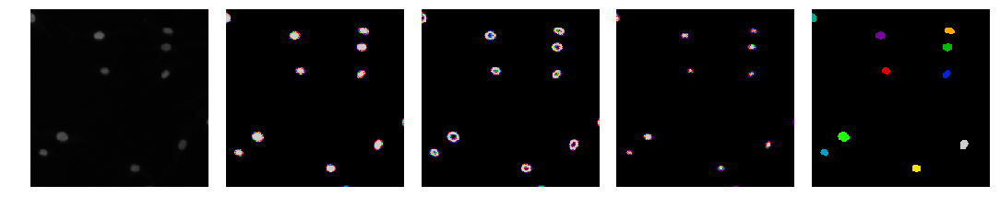

37


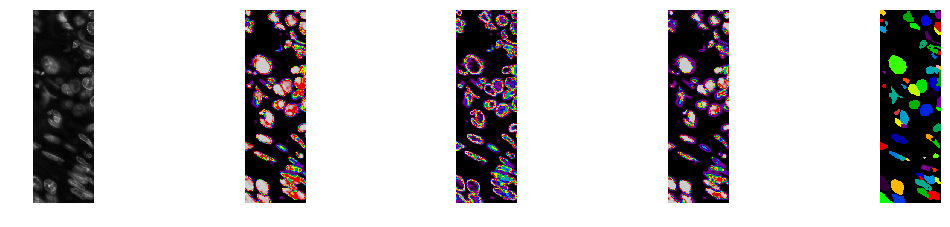

38


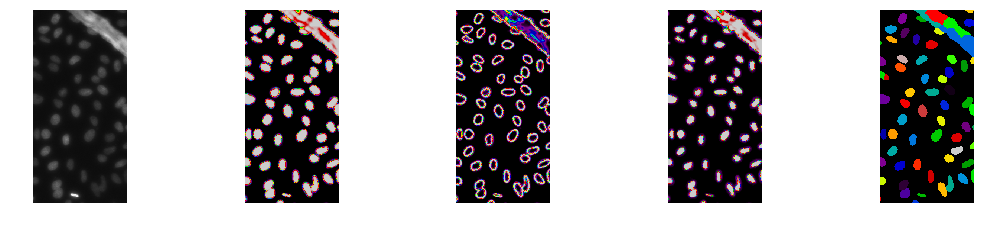

39


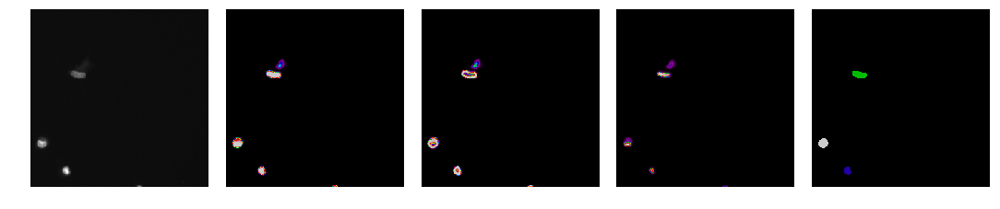

40


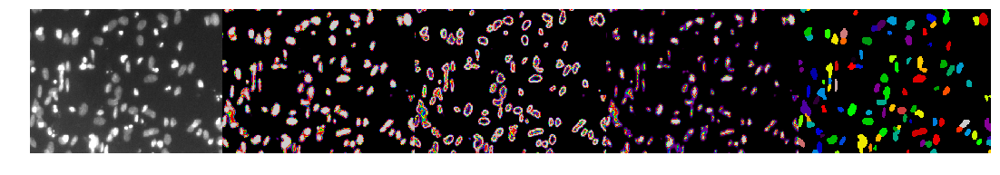

41


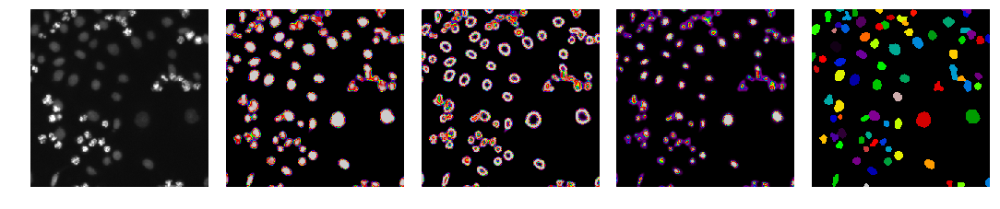

42


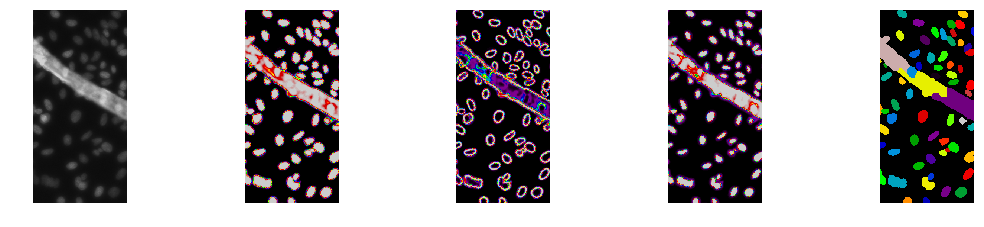

43


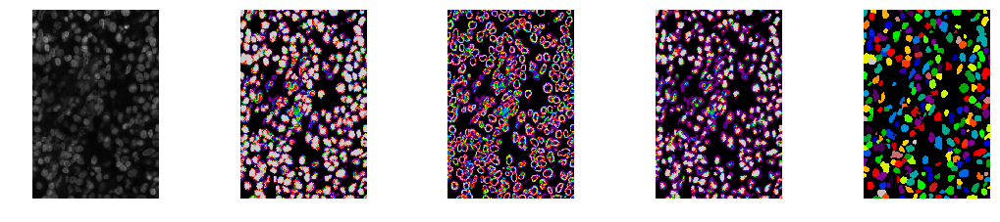

44


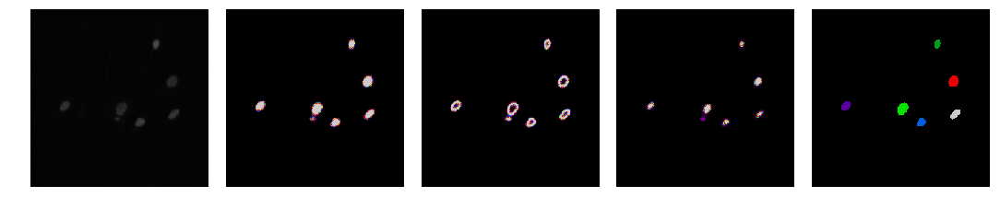

45


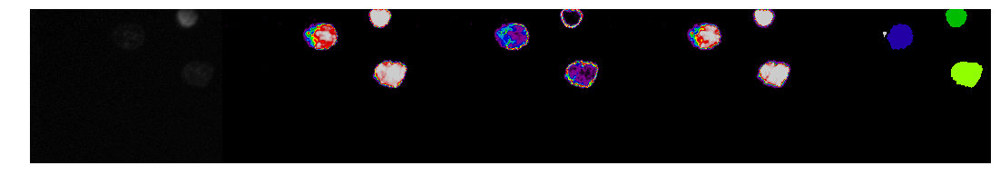

46


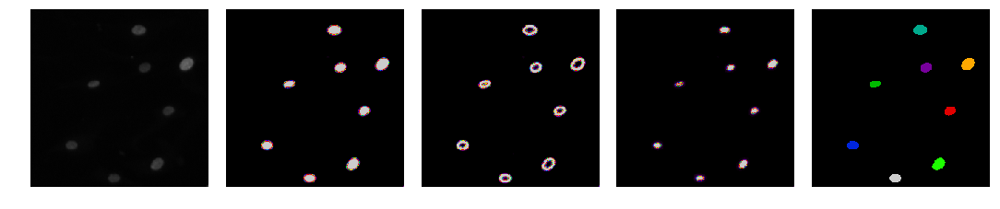

47


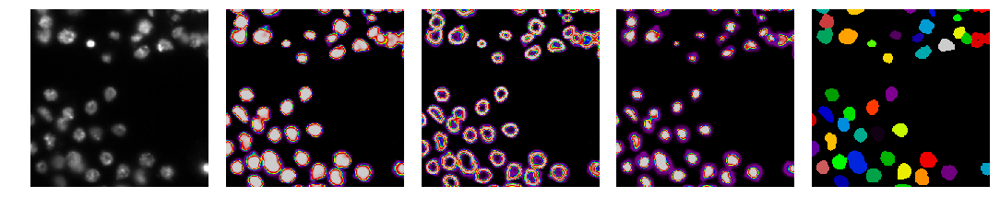

48


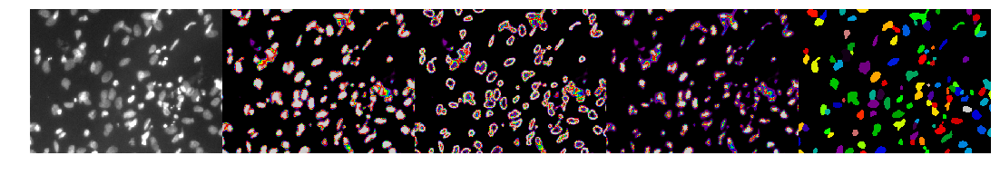

49


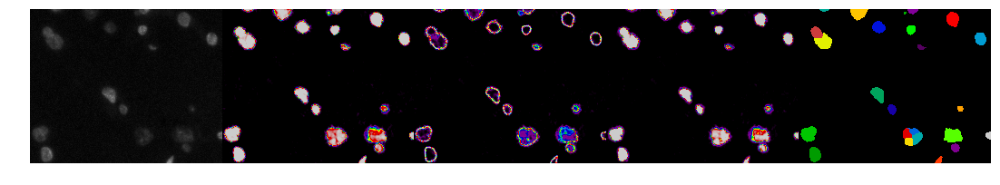

50


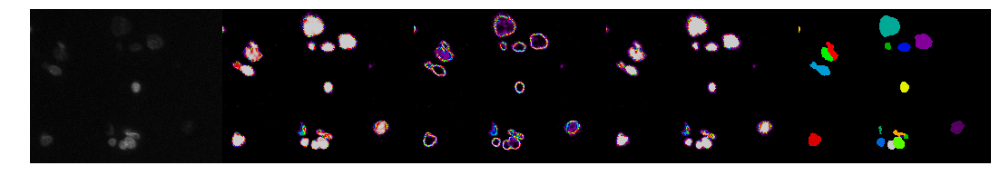

51


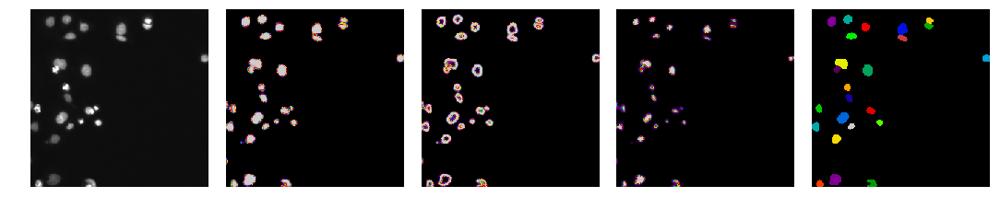

52


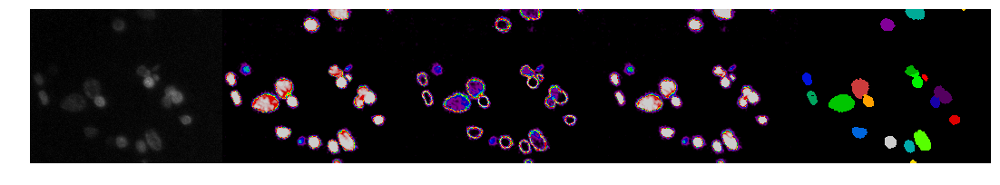

53


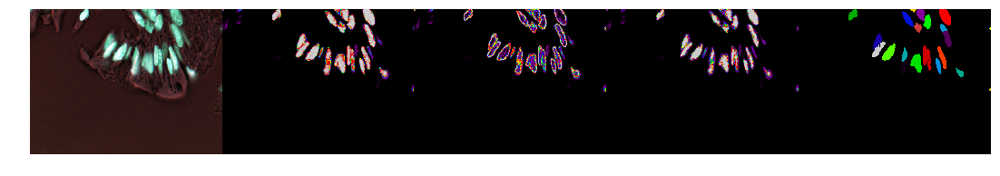

54


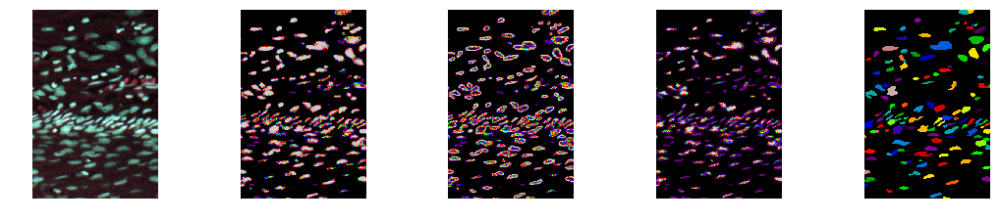

55


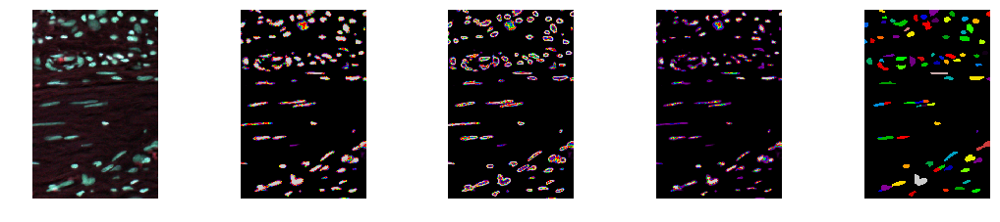

56


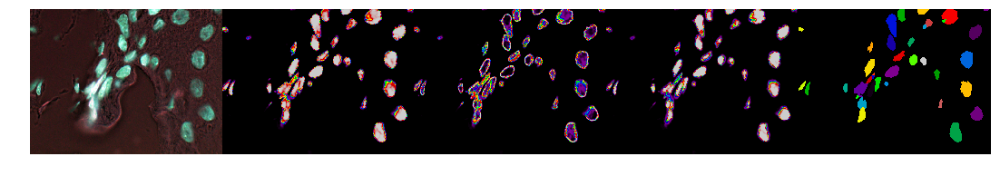

57


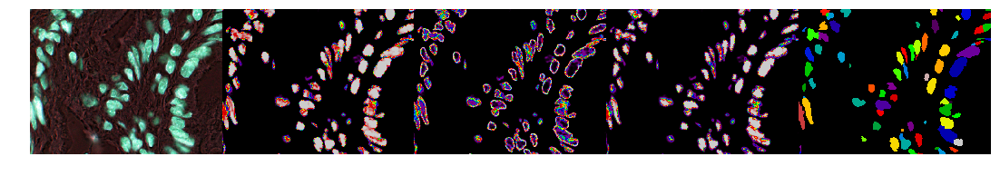

58


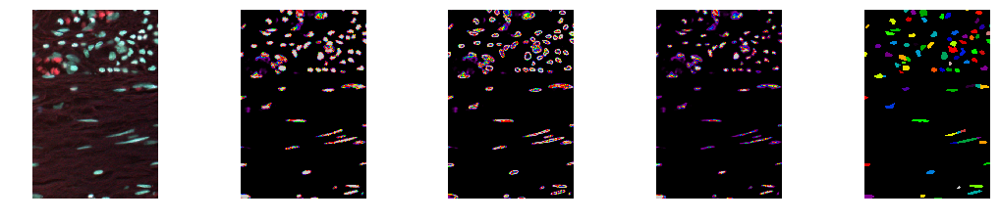

59


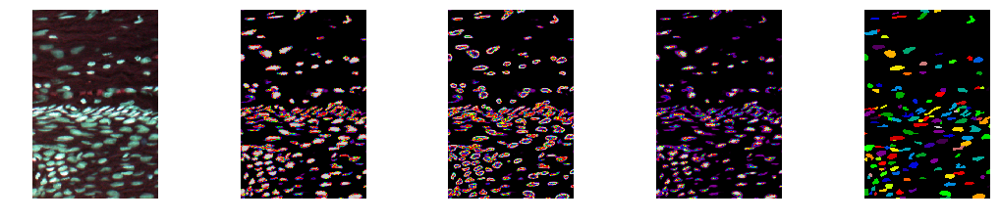

60


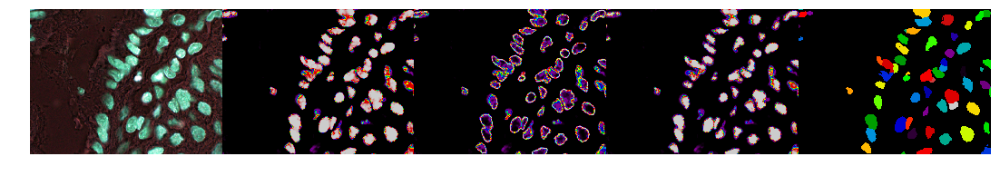

61


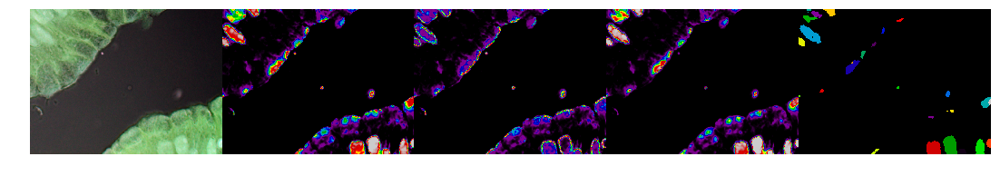

62


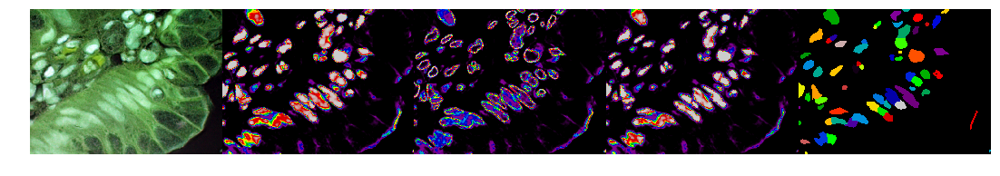

63


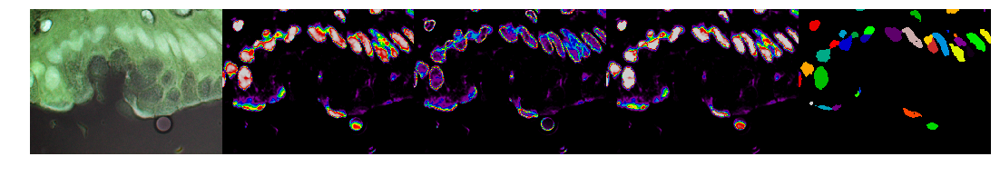

64


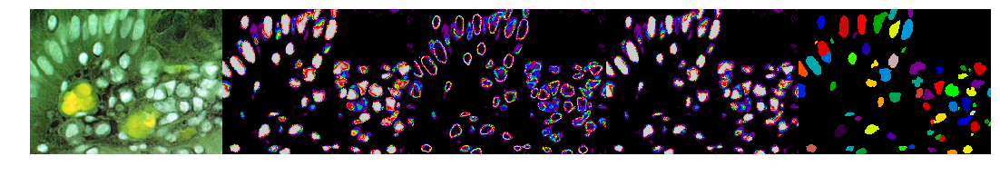

In [357]:
for i in range(len(test_images)):
    print(i)
    draw.plots([
      test_images[i],
      test_predictions[i][..., 0], 
      test_predictions[i][..., 1],
      test_predictions[i][..., 2],
      watershed(
        test_predictions[i], mask_threshold=0.5, center_threshold=0.7, width_holes=4, 
    width_objects=3, sigma=3, padding_size=5, min_size=16, footprint=np.ones((3, 3))
    ) * 12367 % 1000,
    ], scale=3, col_number=5)
    plt.show()

In [365]:
new_ids, rles = utils.mask2rle(test_predictions, test_names, lambda x: watershed(
        x, mask_threshold=0.5, center_threshold=0.7, width_holes=4, 
    width_objects=3, sigma=3, padding_size=5, min_size=16, footprint=np.ones((3, 3))
))

100%|██████████| 65/65 [00:03<00:00, 19.90it/s]


In [366]:
from datetime import datetime
sub = utils.make_submission(
    '../subs/{}.csv'.format(datetime.now()), new_ids, rles
)

In [367]:
sub.shape

(3349, 2)